<a href="https://colab.research.google.com/github/ahmadryan/covid19/blob/master/coronavirus_models_qudsi.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**a quick, possibly (certainly) buggy analysis of the cornavirus data on Kaggle https://www.kaggle.com/sudalairajkumar/novel-corona-virus-2019-dataset**

Visualizing the number of deaths, and the presence of the virus by country

TODO: 
* export the bokeh interactive plot to the web
* normalize by population
* review and kill bugs
* review and simplify syntax
* review and comment for posterity

In [1]:
!pip install geopandas
!pip install shapely

     |████████████████████████████████| 931kB 2.7MB/s 
     |████████████████████████████████| 14.7MB 291kB/s 
     |████████████████████████████████| 10.4MB 37.8MB/s 


In [2]:
import pandas as pd
import pylab as pl
import geopandas as gpd
import shapely
import json
import matplotlib as mpl

%pylab inline

Populating the interactive namespace from numpy and matplotlib


In [0]:
#remove warnings
if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")


In [0]:
#bokeh imports
from bokeh.io import output_file, show, output_notebook, export_png
from bokeh.models import ColumnDataSource, GeoJSONDataSource, LinearColorMapper, ColorBar
from bokeh.plotting import figure
from bokeh.palettes import brewer
from bokeh.models import HoverTool
from bokeh.palettes import viridis, inferno, cividis, plasma, gray

In [0]:
#does not work on colab
#!pip install panel
#import panel as pn
#import panel.widgets as pnw
#pn.extension()
#output_notebook()
#output_file("test.html")


In [5]:
# most of the data I grab from online links 
# but the shapefiles downloaded and saved on data/
# the last part of the analysis uses worldbank data 
# which I also downloaded and saved on data/ - that could be changed
from google.colab import drive

drive.mount("/content/gdrive")


Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/gdrive


In [6]:
cd gdrive/My\ Drive


/content/gdrive/My Drive


In [7]:
cd cv19/covid_data/

/content/gdrive/My Drive/cv19/covid_data


# COVID-19 death analysis



In [0]:
# JHU database on COVID-19
# https://github.com/CSSEGISandData/COVID-19/tree/master/csse_covid_19_data
root = "https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/"
# get the number of dead people
deaths = pd.read_csv(root + "/time_series_covid19_deaths_global.csv")
#deaths = pd.read_csv(root + "/time_series_19-covid-Deaths.csv")
confirmed = pd.read_csv(root + "/time_series_covid19_confirmed_global.csv")

In [116]:
deaths.describe()

,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20
count,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000
mean,21.963583,25.862743,0.071429,0.075630,0.109244,0.176471,0.235294,0.344538,0.550420,0.558824,0.718487,0.894958,1.088235,1.521008,1.789916,2.067227,2.369748,2.663866,3.021008,3.386555,3.806723,4.256303,4.676471,4.697479,5.760504,6.399160,7.000000,7.436975,7.848739,8.432773,8.915966,9.441176,9.457983,10.327731,10.373950,11.046218,11.378151,11.638655,11.823529,12.067227,12.357143,12.588235,12.962185,13.277311,13.672269,14.067227,14.537815,14.949580,15.974790,16.756303,17.907563,19.390756,19.831933,22.705882,24.449580,27.058824,29.941176,33.214286,36.693277,41.457983,47.474790,54.508403,61.558824,69.348739
std,24.715655,70.957853,1.101946,1.103578,1.557830,2.593881,3.372027,4.927212,8.102428,8.102892,10.500982,13.222914,16.139313,22.685466,26.833720,31.046645,35.583471,40.055927,45.305568,50.555331,56.452852,63.128540,69.221045,69.220501,84.904944,94.433221,103.442558,109.923229,115.951477,124.507272,131.505985,138.957461,138.956556,152.048327,152.046569,161.702995,166.110100,169.480130,171.167086,173.827658,176.751878,178.966343,181.714742,183.833759,186.241149,188.379531,190.467215,192.489524,195.215059,197.638782,200.825532,205.509685,206.705821,216.927192,223.326584,236.395267,251.016391,267.745534,290.697899,314.617168,349.834508,396.482591,439.560994,484.451798
min,-41.454500,-123.120700,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,7.641625,-13.263450,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,24.487000,21.758700,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000

In [117]:
confirmed.describe()

,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20
count,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000,238.000000
mean,21.963583,25.862743,2.331933,2.747899,3.953782,6.025210,8.899160,12.298319,23.436975,25.907563,34.596639,41.710084,50.579832,70.533613,83.533613,100.386555,116.113445,129.386555,144.500000,155.966387,168.697479,179.672269,188.243697,190.004202,253.647059,281.029412,290.042017,299.260504,307.806723,315.697479,317.810924,320.155462,322.768908,330.134454,331.756303,334.289916,337.840336,341.966387,347.672269,353.411765,361.390756,371.298319,379.436975,390.084034,399.663866,411.268908,427.705882,444.668067,461.365546,477.189076,498.327731,528.886555,539.298319,610.121849,655.899160,703.588235,762.911765,828.361345,902.978992,1019.773109,1143.546218,1279.491597,1416.340336,1590.533613
std,24.715655,70.957853,28.835689,28.936193,36.017254,50.120523,70.035964,94.357741,231.648874,233.036007,321.151707,380.745222,468.537774,728.241119,880.367307,1085.042908,1278.667793,1437.406180,1621.537666,1760.761913,1924.689276,2060.517423,2166.653841,2166.996972,3126.810147,3528.193257,3647.595280,3772.800496,3889.830950,3999.480327,4022.108730,4048.707582,4063.019381,4155.070233,4155.096444,4168.296948,4200.651840,4226.803661,4253.860428,4275.467409,4304.854307,4344.125546,4359.773474,4372.749461,4384.738428,4399.519674,4417.561542,4435.715835,4452.894098,4473.269816,4489.995700,4524.760150,4535.478236,4633.170476,4718.912437,4818.905841,4938.159871,5080.109910,5270.653646,5576.276863,5947.705774,6398.487874,6858.958946,7497.352027
min,-41.454500,-123.120700,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,7.641625,-13.263450,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,2.000000,3.000000,3.250000,6.000000,6.250000,10.250000,12.250000
50%,24.487000,21.758700,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00

In [118]:
deaths.head()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20
0,NaN,Afghanistan,33.0000,65.0000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1
1,NaN,Albania,41.1533,20.1683,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,2,2,2,2,2,4
2,NaN,Algeria,28.0339,1.6596,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,2,3,4,4,4,7,9,11,15,17,17
3,NaN,Andorra,42.5063,1.5218,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1
4,NaN,Angola,-11.2027,17.8739,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [119]:
confirmed.columns

Index(['Province/State', 'Country/Region', 'Lat', 'Long', '1/22/20', '1/23/20',
       '1/24/20', '1/25/20', '1/26/20', '1/27/20', '1/28/20', '1/29/20',
       '1/30/20', '1/31/20', '2/1/20', '2/2/20', '2/3/20', '2/4/20', '2/5/20',
       '2/6/20', '2/7/20', '2/8/20', '2/9/20', '2/10/20', '2/11/20', '2/12/20',
       '2/13/20', '2/14/20', '2/15/20', '2/16/20', '2/17/20', '2/18/20',
       '2/19/20', '2/20/20', '2/21/20', '2/22/20', '2/23/20', '2/24/20',
       '2/25/20', '2/26/20', '2/27/20', '2/28/20', '2/29/20', '3/1/20',
       '3/2/20', '3/3/20', '3/4/20', '3/5/20', '3/6/20', '3/7/20', '3/8/20',
       '3/9/20', '3/10/20', '3/11/20', '3/12/20', '3/13/20', '3/14/20',
       '3/15/20', '3/16/20', '3/17/20', '3/18/20', '3/19/20', '3/20/20',
       '3/21/20', '3/22/20', '3/23/20'],
      dtype='object')

In [120]:
where( deaths['Country/Region'] == 'US' )[0]

array([225])

In [121]:
firstdate = pd.to_datetime(deaths.columns[4])
firstdate

Timestamp('2020-01-22 00:00:00')

In [0]:
# last day contains the cumulative death rate
deaths["totaldeaths"] = deaths[deaths.columns[-1]]
confirmed["totalconfirmed"] = confirmed[confirmed.columns[-1]]

In [0]:
# combine lat and lon to one column
lonlat_deaths = list(zip(deaths.Long, 
                  deaths.Lat))

lonlat_confirmed = list(zip(confirmed.Long, 
                  confirmed.Lat))

In [127]:
deaths.tail()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,totaldeaths
233,NaN,Grenada,12.116500,-61.679000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
234,NaN,Mozambique,-18.665695,35.529562,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
235,NaN,Syria,34.802075,38.996815,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
236,NaN,Timor-Leste,-8.874217,125.727539,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
237,NaN,Belize,13.193900,-59.543200,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [128]:
confirmed.tail()

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,totalconfirmed
233,NaN,Grenada,12.116500,-61.679000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1
234,NaN,Mozambique,-18.665695,35.529562,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1
235,NaN,Syria,34.802075,38.996815,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1
236,NaN,Timor-Leste,-8.874217,125.727539,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1
237,NaN,Belize,13.193900,-59.543200,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1


In [129]:
# creating the geometry
# Create Point Geometry for based on lonlat column

deaths.reset_index(inplace=True)
deaths = gpd.GeoDataFrame(deaths)
deaths["lonlat"] = lonlat_deaths

deaths['geometry'] = deaths[['lonlat']].applymap(lambda x:shapely.geometry.Point(x))
deaths.head()

,index,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,totaldeaths,lonlat,geometry
0,0,NaN,Afghanistan,33.0000,65.0000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,"(65.0, 33.0)",POINT (65.00000 33.00000)
1,1,NaN,Albania,41.1533,20.1683,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,2,2,2,2,2,4,4,"(20.1683, 41.1533)",POINT (20.16830 41.15330)
2,2,NaN,Algeria,28.0339,1.6596,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,2,3,4,4,4,7,9,11,15,17,17,17,"(1.6596, 28.0339)",POINT (1.65960 28.03390)
3,3,NaN,Andorra,42.5063,1.5218,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,"(1.5218, 42.5063)",POINT (1.52180 42.50630)
4,4,NaN,Angola,-11.2027,17.8739,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,"(17.8739, -11.2027)",POINT (17.87390 -11.20270)


In [130]:
# creating the geometry
# Create Point Geometry for based on lonlat column

confirmed.reset_index(inplace=True)
confirmed = gpd.GeoDataFrame(confirmed)
confirmed["lonlat"] = lonlat_confirmed

confirmed['geometry'] = confirmed[['lonlat']].applymap(lambda x:shapely.geometry.Point(x))
confirmed.head()

,index,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,totalconfirmed,lonlat,geometry
0,0,NaN,Afghanistan,33.0000,65.0000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,4,4,5,7,7,7,11,16,21,22,22,22,24,24,40,40,40,"(65.0, 33.0)",POINT (65.00000 33.00000)
1,1,NaN,Albania,41.1533,20.1683,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,10,12,23,33,38,42,51,55,59,64,70,76,89,104,104,"(20.1683, 41.1533)",POINT (20.16830 41.15330)
2,2,NaN,Algeria,28.0339,1.6596,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,3,5,12,12,17,17,19,20,20,20,24,26,37,48,54,60,74,87,90,139,201,230,230,"(1.6596, 28.0339)",POINT (1.65960 28.03390)
3,3,NaN,Andorra,42.5063,1.5218,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,2,39,39,53,75,88,113,133,133,"(1.5218, 42.5063)",POINT (1.52180 42.50630)
4,4,NaN,Angola,-11.2027,17.8739,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,2,2,3,3,"(17.8739, -11.2027)",POINT (17.87390 -11.20270)


In [22]:
!ls

age.csv
COVID-19-confirmed-2020-01-22-2020-03-22_5fps.mp4
COVID-19-deaths-2020-01-22-2020-03-22_1fps.mp4
COVID-19-deaths-2020-01-22-2020-03-22_5fps.mp4
covid-19-tests-country.csv
gdp.csv
gdpgrowth.csv
land.csv
pop.csv
populationGDP.csv
time_series_19-covid-Confirmed.csv
time_series_19-covid-Deaths.csv
time_series_19-covid-Recovered.csv
TM_WORLD_BORDERS_SIMPL-0.3.dbf
TM_WORLD_BORDERS_SIMPL-0.3.prj
TM_WORLD_BORDERS_SIMPL-0.3.shp
TM_WORLD_BORDERS_SIMPL-0.3.shx
urban.csv


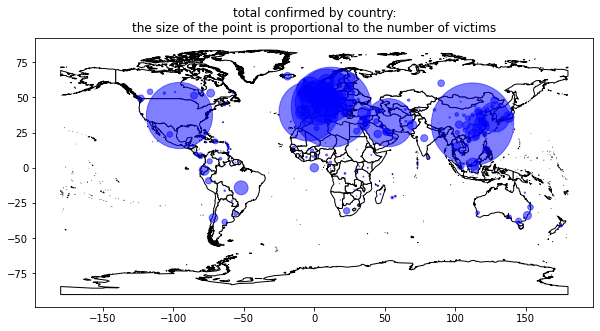

In [131]:
world = gpd.GeoDataFrame.from_file("TM_WORLD_BORDERS_SIMPL-0.3.shp")
ax = world.plot(figsize=(10,10), edgecolor="k", facecolor="w")
confirmed.plot(ax=ax, #column="Country/Region", 
            markersize=confirmed.totalconfirmed * 0.1, alpha=0.5, color='Blue')
ax.axis("on")
ax.set_title("total confirmed by country:\n" + 
             "the size of the point is proportional to the number of victims" );

In [132]:
india =  world[world.NAME == "India"]
type(india)

geopandas.geodataframe.GeoDataFrame

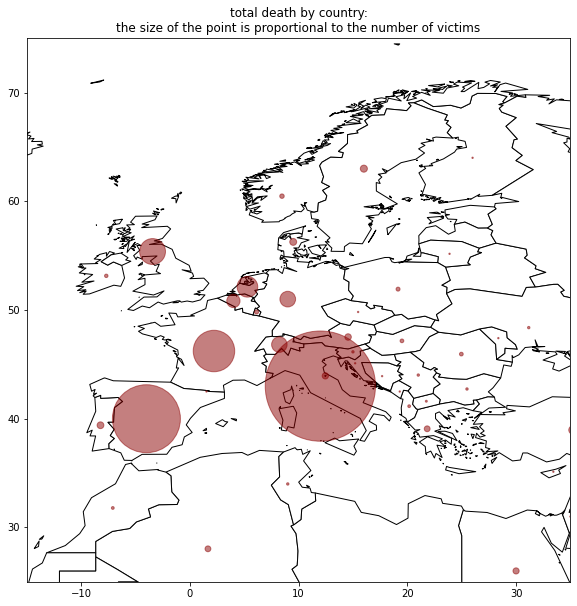

In [140]:
world = gpd.GeoDataFrame.from_file("TM_WORLD_BORDERS_SIMPL-0.3.shp")
ax = world.plot(figsize=(10,10), edgecolor="k", facecolor="w")
deaths.plot(ax=ax, #column="Country/Region", 
            markersize=deaths.totaldeaths * 2, alpha=0.5, color='DarkRed')
ax.axis("on")
ax.set_title("total death by country:\n" + 
             "the size of the point is proportional to the number of victims" );

ax.set_xlim(-15, 35)
ax.set_ylim(25, 75);

In [0]:
# I want the data as granular as country. 
# More granular would be great but I could not map it wisely 
# (I would need to find a map of provinces worldwide 
# and do a lot of name matching to merge properly)
deaths["Country/Region"].replace("Mainland China", "China", inplace=True)
deaths["Country/Region"].replace("UK", "United Kingdom", inplace=True)
deaths["Country/Region"].replace("US", "United States", inplace=True)
deaths = deaths.groupby("Country/Region").sum()
#deaths['logtotaldeaths'] = np.log10(deaths['totaldeaths'] + 1)

confirmed["Country/Region"].replace("Mainland China", "China", inplace=True)
confirmed["Country/Region"].replace("UK", "United Kingdom", inplace=True)
confirmed["Country/Region"].replace("US", "United States", inplace=True)
confirmed = confirmed.groupby("Country/Region").sum()
#confirmed['logtotalconfirmed'] = np.log10(confirmed['totalconfirmed'] + 1)

In [142]:
confirmed.head()

,index,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,totalconfirmed
Country/Region,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Afghanistan,0,33.0000,65.0000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,4,4,5,7,7,7,11,16,21,22,22,22,24,24,40,40,40
Albania,1,41.1533,20.1683,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,10,12,23,33,38,42,51,55,59,64,70,76,89,104,104
Algeria,2,28.0339,1.6596,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,3,5,12,12,17,17,19,20,20,20,24,26,37,48,54,60,74,87,90,139,201,230,230
Andorra,3,42.5063,1.5218,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,2,39,39,53,75,88,113,133,133
Angola,4,-11.2027,17.8739,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,2,2,3,3


In [0]:
deaths["firstoccurrence"] = np.zeros(len(deaths)) * np.nan
for i in deaths.index:
    done = False
    for j in range(0, len(deaths.columns)):
        #print(i,j, deaths.iloc[i,j], done)
        if done:
            break
        try :
          pd.to_datetime(deaths.columns[j])
        except ValueError:
          continue
        #print(i, j, deaths.iloc[i,j])
        if (deaths.loc[i][j]) > 0: 
            #print("\t", i,j, deaths.iloc[i,j], done)
            deaths.loc[i, "firstoccurrence"] = pd.to_datetime(deaths.columns[j])          
            done = True

confirmed["firstoccurrence"] = np.zeros(len(confirmed)) * np.nan
for i in confirmed.index:
    done = False
    for j in range(0, len(confirmed.columns)):
        #print(i,j, confirmed.iloc[i,j], done)
        if done:
            break
        try :
          pd.to_datetime(confirmed.columns[j])
        except ValueError:
          continue
        #print(i, j, confirmed.iloc[i,j])
        if (confirmed.loc[i][j]) > 0: 
            #print("\t", i,j, confirmed.iloc[i,j], done)
            confirmed.loc[i, "firstoccurrence"] = pd.to_datetime(confirmed.columns[j])          
            done = True

In [144]:
deaths["firstoccurrence"] 

Country/Region
Afghanistan    2020-03-22 00:00:00
Albania        2020-03-11 00:00:00
Algeria        2020-03-12 00:00:00
Andorra        2020-03-22 00:00:00
Angola                         NaN
                      ...         
Uzbekistan                     NaN
Venezuela                      NaN
Vietnam                        NaN
Zambia                         NaN
Zimbabwe       2020-03-23 00:00:00
Name: firstoccurrence, Length: 168, dtype: object

In [145]:
deaths.iloc[0, 0], deaths.iloc[0, j], i, j, deaths.columns[j]

(0, 0, 'Zimbabwe', 62, '3/21/20')

In [149]:
confirmed.iloc[0, 1], confirmed.iloc[0, j], i, j, confirmed.columns[j]

(33.0, 24, 'Zimbabwe', 62, '3/21/20')

In [150]:
deaths.describe()

,index,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,totaldeaths
count,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.00000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000
mean,167.875000,31.115076,36.638886,0.101190,0.107143,0.154762,0.25000,0.333333,0.488095,0.779762,0.791667,1.017857,1.267857,1.541667,2.154762,2.535714,2.928571,3.357143,3.773810,4.279762,4.797619,5.392857,6.029762,6.625000,6.654762,8.160714,9.065476,9.916667,10.535714,11.119048,11.946429,12.630952,13.375000,13.398810,14.630952,14.696429,15.648810,16.119048,16.488095,16.750000,17.095238,17.505952,17.833333,18.363095,18.809524,19.369048,19.928571,20.595238,21.178571,22.630952,23.738095,25.369048,27.470238,28.095238,32.166667,34.636905,38.333333,42.416667,47.053571,51.982143,58.732143,67.255952,77.220238,87.208333,98.244048,98.244048
std,220.453973,99.171369,312.097886,1.311578,1.388730,2.005944,3.24037,4.320494,6.326437,10.106869,10.261173,13.192936,16.433307,19.982284,27.851400,32.789091,37.881089,43.436000,48.836609,55.394494,62.106684,69.821846,78.077071,85.792235,86.177994,105.619775,117.346824,128.301918,136.248096,143.808956,154.533033,163.250315,172.661508,172.659928,188.475242,188.626639,200.196824,205.596017,209.606017,211.843258,215.240104,218.871603,221.581108,224.844735,227.436481,230.290433,232.898389,235.362155,237.750091,240.996995,243.891338,247.554810,252.946586,254.407501,266.233108,273.583438,288.632096,305.527098,324.955147,351.649807,379.471228,420.637811,475.320093,525.951705,578.698669,578.698669
min,0.000000,-255.969500,-977.783200,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,95.750000,6.105875,-9.496275,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,147.500000,21.000000,19.401650,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000

In [151]:
confirmed.describe()

,index,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20,totalconfirmed
count,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000
mean,167.875000,31.115076,36.638886,3.303571,3.892857,5.601190,8.535714,12.607143,17.422619,33.202381,36.702381,49.011905,59.089286,71.654762,99.922619,118.339286,142.214286,164.494048,183.297619,204.708333,220.952381,238.988095,254.535714,266.678571,269.172619,359.333333,398.125000,410.892857,423.952381,436.059524,447.238095,450.232143,453.553571,457.255952,467.690476,469.988095,473.577381,478.607143,484.452381,492.535714,500.666667,511.970238,526.005952,537.535714,552.619048,566.190476,582.630952,605.916667,629.946429,653.601190,676.017857,705.964286,749.255952,764.005952,864.339286,929.190476,996.750000,1080.791667,1173.511905,1279.220238,1444.678571,1620.023810,1812.613095,2006.482143,2253.255952,2253.255952
std,220.453973,99.171369,312.097886,42.276642,49.604669,70.972386,108.465005,160.073263,221.945170,424.999902,469.589036,628.052174,756.187648,917.347850,1282.963962,1521.049920,1828.953489,2116.955986,2359.746768,2631.521946,2840.128796,3072.734500,3267.515000,3424.282855,3453.049908,4620.805192,5119.419555,5277.943519,5439.942596,5588.139879,5725.235195,5756.716632,5792.018460,5828.457376,5940.335413,5941.923728,5958.821316,5998.398539,6030.293478,6064.216465,6090.384131,6125.183952,6171.724299,6190.157558,6205.018488,6218.870127,6236.208827,6257.285436,6276.178128,6294.138551,6314.437749,6331.275484,6366.600192,6377.223631,6473.107921,6559.955165,6661.110383,6782.247174,6926.859985,7123.923563,7441.783440,7835.717146,8316.898796,8818.360978,9516.057050,9516.057050
min,0.000000,-255.969500,-977.783200,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
25%,95.750000,6.105875,-9.496275,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,2.000000,3.000000,5.750000,6.000000,6.750000,9.750000,9.750000
50%,147.500000,21.000000,19.401650,0.000000,0.000000,0.

In [152]:
print ("as of {}".format(pd.to_datetime("today").date()))
print ("number of countries in the database {:d}".format(len(deaths)))
print ("number of countries with at least 1 death {:d}".format(
    (deaths.totaldeaths > 0).sum()))
print ("number of countries with at least 1 confirmed case {:d}".format(
    (confirmed.totalconfirmed > 0).sum()))

as of 2020-03-24
number of countries in the database 168
number of countries with at least 1 death 90
number of countries with at least 1 confirmed case 168


In [153]:
# how many days are in the database?
maxday = pd.Timedelta(pd.to_datetime("today").normalize() - pd.to_datetime("01/01/2020"))
maxday -= pd.Timedelta(2, unit="day")
maxday

Timedelta('81 days 00:00:00')

In [154]:
# it will be convenient to have the log number, instead of the natural number, 
# or maps will have too much contrast 
# I am adding it to columns with columname the date, but as a string
def addlogbydate(df):
  for d in df.columns:
    try :
      pd.to_datetime(d)
    except ValueError:
      continue
    df[pd.to_datetime(d).strftime('%Y-%m-%d')] = df[d]
  return df
deaths = addlogbydate(deaths).reset_index()
confirmed = addlogbydate(confirmed).reset_index()
deaths

,Country/Region,index,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,...,2020-02-13,2020-02-14,2020-02-15,2020-02-16,2020-02-17,2020-02-18,2020-02-19,2020-02-20,2020-02-21,2020-02-22,2020-02-23,2020-02-24,2020-02-25,2020-02-26,2020-02-27,2020-02-28,2020-02-29,2020-03-01,2020-03-02,2020-03-03,2020-03-04,2020-03-05,2020-03-06,2020-03-07,2020-03-08,2020-03-09,2020-03-10,2020-03-11,2020-03-12,2020-03-13,2020-03-14,2020-03-15,2020-03-16,2020-03-17,2020-03-18,2020-03-19,2020-03-20,2020-03-21,2020-03-22,2020-03-23
0,Afghanistan,0,33.0000,65.0000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1
1,Albania,1,41.1533,20.1683,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,2,2,2,2,2,4
2,Algeria,2,28.0339,1.6596,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,2,3,4,4,4,7,9,11,15,17,17
3,Andorra,3,42.5063,1.5218,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1
4,Angola,4,-11.2027,17.8739,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
163,Uzbekistan,226,41.3775,64.5853,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
164,Venezuela,227,6.4238,-66.5897,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
165,Vietnam,228,16.0000,108.0000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
166,Zambia,229,-15.4167,28.2833,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [155]:
confirmed

,Country/Region,index,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,...,2020-02-13,2020-02-14,2020-02-15,2020-02-16,2020-02-17,2020-02-18,2020-02-19,2020-02-20,2020-02-21,2020-02-22,2020-02-23,2020-02-24,2020-02-25,2020-02-26,2020-02-27,2020-02-28,2020-02-29,2020-03-01,2020-03-02,2020-03-03,2020-03-04,2020-03-05,2020-03-06,2020-03-07,2020-03-08,2020-03-09,2020-03-10,2020-03-11,2020-03-12,2020-03-13,2020-03-14,2020-03-15,2020-03-16,2020-03-17,2020-03-18,2020-03-19,2020-03-20,2020-03-21,2020-03-22,2020-03-23
0,Afghanistan,0,33.0000,65.0000,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,...,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,4,4,5,7,7,7,11,16,21,22,22,22,24,24,40,40
1,Albania,1,41.1533,20.1683,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,10,12,23,33,38,42,51,55,59,64,70,76,89,104
2,Algeria,2,28.0339,1.6596,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,...,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,3,5,12,12,17,17,19,20,20,20,24,26,37,48,54,60,74,87,90,139,201,230
3,Andorra,3,42.5063,1.5218,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,2,39,39,53,75,88,113,133
4,Angola,4,-11.2027,17.8739,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,2,2,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
163,Uzbekistan,226,41.3775,64.5853,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,6,10,15,23,33,43,43,46
164,Venezuela,227,6.4238,-66.5897,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,10,17,33,36,42,42,70,70,77
165,Vietnam,228,16.0000,108.0000,0,2,2,2,2,2,2,2,2,2,6,6,8,8,8,10,10,13,13,14,15,15,16,16,16,16,16,16,16,16,16,16,16,16,16,16,...,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,18,30,30,31,38,39,47,53,56,61,66,75,85,91,94,113,123
166,Zambia,229,-15.4167,28.2833,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,2,2,2,3,3


In [0]:
def get_dataset(df=None, day=None, key="firstoccurrence"):
    ''' this produces a geodataframe by country with the number of deaths by day
    df: the dataframe with covid data
    day: the date to be plotted in days since 01/01/2020
    key: only used if day is None - name of a column, it will extract data for that column
    returns the dataframe combined with a world map and converted to a dataframe, the column used'''
    if day is None:
      newt = key
      print('Day was None')
    else:
      newt = (pd.to_datetime("1/1/2020") + pd.Timedelta(day, "D")).strftime('%Y-%m-%d')

    if newt not in df.columns:
        raise ValueError('Number out of range. Please ensure that the number\
        of days lies between 0 and number of days passed since January 1st, 2020')
        return
        #newt = firstdate.strftime('%Y-%m-%d')
    
    worlddeaths = world[["NAME", "geometry"]].merge(
        df[["Country/Region", newt]], 
        left_on="NAME", right_on="Country/Region", how="left")
    
    worlddeaths = gpd.GeoDataFrame(worlddeaths.groupby("NAME").sum().reset_index(
    ).merge(worlddeaths[["NAME", "geometry"]].drop_duplicates(subset="NAME"), 
            on="NAME", how="left"))
    worlddeaths[newt] = worlddeaths[newt].fillna(0)
    
    return worlddeaths, newt
#get_dataset(1)

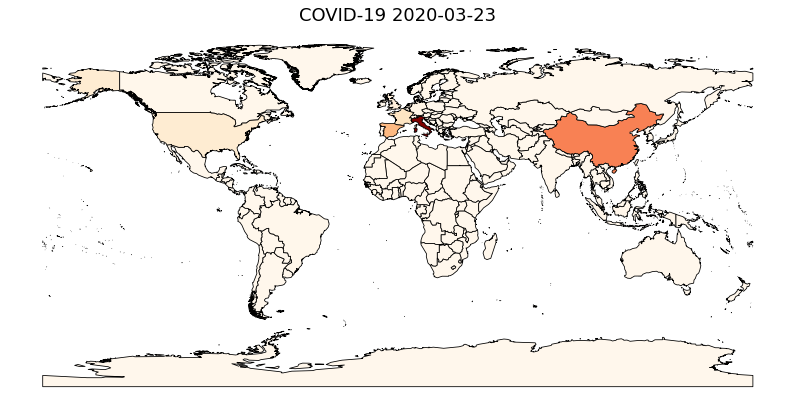

In [182]:
data_deaths, key_deaths = get_dataset(df=deaths, day=82)

fig, ax = plt.subplots(1, figsize=(14, 8))
data_deaths.plot(column=key_deaths, 
          clim=(0,100), cmap='OrRd', 
          linewidth=0.8, ax=ax, edgecolor='black')

ax.axis('off')
ax.set_title('COVID-19 %s'%key_deaths, fontsize=18);

In [183]:
data_deaths.head()

,NAME,2020-03-23,geometry
0,Afghanistan,1.0,"POLYGON ((74.91574 37.23733, 74.39221 37.17507..."
1,Albania,4.0,"POLYGON ((19.43621 41.02107, 19.60056 41.79666..."
2,Algeria,17.0,"POLYGON ((2.96361 36.80222, 4.78583 36.89472, ..."
3,American Samoa,0.0,"MULTIPOLYGON (((-170.54251 -14.29750, -170.560..."
4,Andorra,1.0,"POLYGON ((1.78172 42.56996, 1.72361 42.50944, ..."


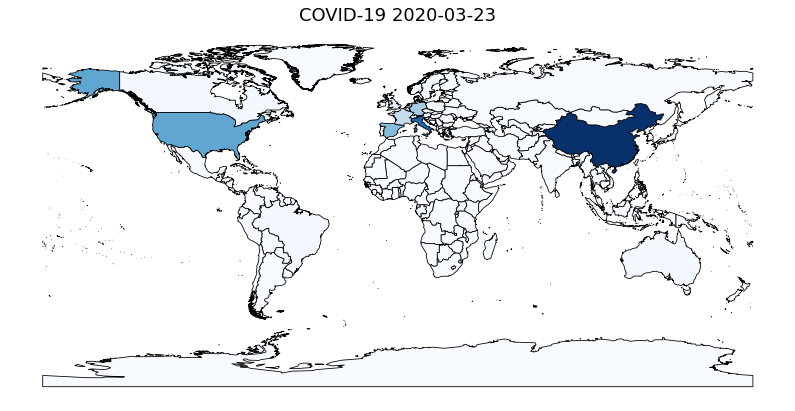

In [184]:
data_confirmed, key_confirmed = get_dataset(df=confirmed, day=82)

fig, ax = plt.subplots(1, figsize=(14, 8))
data_confirmed.plot(column=key_confirmed, 
          clim=(0,100), cmap='Blues', 
          linewidth=0.8, ax=ax, edgecolor='black')
ax.axis('off')
ax.set_title('COVID-19 %s'%key_confirmed, fontsize=18);

In [0]:
# this is for a dynamic bokeh map that does not work on google colab
def map_dash():
    """Map dashboard"""

    from bokeh.models.widgets import DataTable
    map_pane = pn.pane.Bokeh(width=400, height=300)
    #data_select = pnw.Select(name='dataset',options=list(
    #    datatmp))
    day_slider = pnw.IntSlider(start=22, end=90, value=25)
    
    def update_map(event):
        #data,key = get_dataset(day=0)
        #data = gpd.GeoDataFrame(data.groupby("NAME").sum().reset_index(
        #    ).merge(data[["NAME", "geometry"]].drop_duplicates(subset="NAME"), 
        #        on="NAME", how="left"))#.plot()

        gdf,key = get_dataset(day=day_slider.value)        
        #print("here", gdf, key)
        map_pane.object = bokeh_plot_map(gdf, key)        
        return
    day_slider.param.watch(update_map,'value')
    day_slider.param.trigger('value')
    #data_select.param.watch(update_map,'value')
    app = pn.Column(pn.Row("days since 01/01/2020", #data_select, 
        day_slider),map_pane)
    return app

#app = map_dash()
#app

In [165]:
deaths.describe()

,index,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,...,2020-02-13,2020-02-14,2020-02-15,2020-02-16,2020-02-17,2020-02-18,2020-02-19,2020-02-20,2020-02-21,2020-02-22,2020-02-23,2020-02-24,2020-02-25,2020-02-26,2020-02-27,2020-02-28,2020-02-29,2020-03-01,2020-03-02,2020-03-03,2020-03-04,2020-03-05,2020-03-06,2020-03-07,2020-03-08,2020-03-09,2020-03-10,2020-03-11,2020-03-12,2020-03-13,2020-03-14,2020-03-15,2020-03-16,2020-03-17,2020-03-18,2020-03-19,2020-03-20,2020-03-21,2020-03-22,2020-03-23
count,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.00000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,...,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000
mean,167.875000,31.115076,36.638886,0.101190,0.107143,0.154762,0.25000,0.333333,0.488095,0.779762,0.791667,1.017857,1.267857,1.541667,2.154762,2.535714,2.928571,3.357143,3.773810,4.279762,4.797619,5.392857,6.029762,6.625000,6.654762,8.160714,9.065476,9.916667,10.535714,11.119048,11.946429,12.630952,13.375000,13.398810,14.630952,14.696429,15.648810,16.119048,16.488095,16.750000,...,8.160714,9.065476,9.916667,10.535714,11.119048,11.946429,12.630952,13.375000,13.398810,14.630952,14.696429,15.648810,16.119048,16.488095,16.750000,17.095238,17.505952,17.833333,18.363095,18.809524,19.369048,19.928571,20.595238,21.178571,22.630952,23.738095,25.369048,27.470238,28.095238,32.166667,34.636905,38.333333,42.416667,47.053571,51.982143,58.732143,67.255952,77.220238,87.208333,98.244048
std,220.453973,99.171369,312.097886,1.311578,1.388730,2.005944,3.24037,4.320494,6.326437,10.106869,10.261173,13.192936,16.433307,19.982284,27.851400,32.789091,37.881089,43.436000,48.836609,55.394494,62.106684,69.821846,78.077071,85.792235,86.177994,105.619775,117.346824,128.301918,136.248096,143.808956,154.533033,163.250315,172.661508,172.659928,188.475242,188.626639,200.196824,205.596017,209.606017,211.843258,...,105.619775,117.346824,128.301918,136.248096,143.808956,154.533033,163.250315,172.661508,172.659928,188.475242,188.626639,200.196824,205.596017,209.606017,211.843258,215.240104,218.871603,221.581108,224.844735,227.436481,230.290433,232.898389,235.362155,237.750091,240.996995,243.891338,247.554810,252.946586,254.407501,266.233108,273.583438,288.632096,305.527098,324.955147,351.649807,379.471228,420.637811,475.320093,525.951705,578.698669
min,0.000000,-255.969500,-977.783200,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0

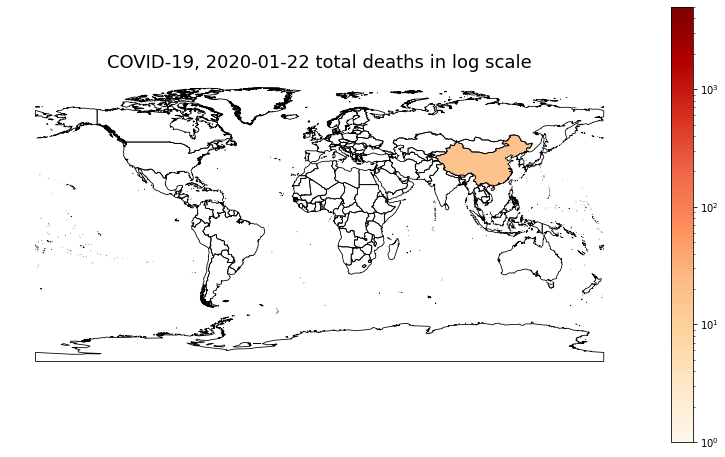

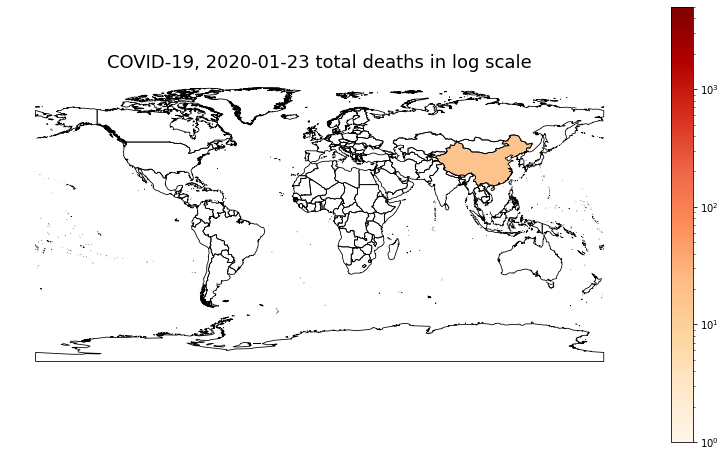

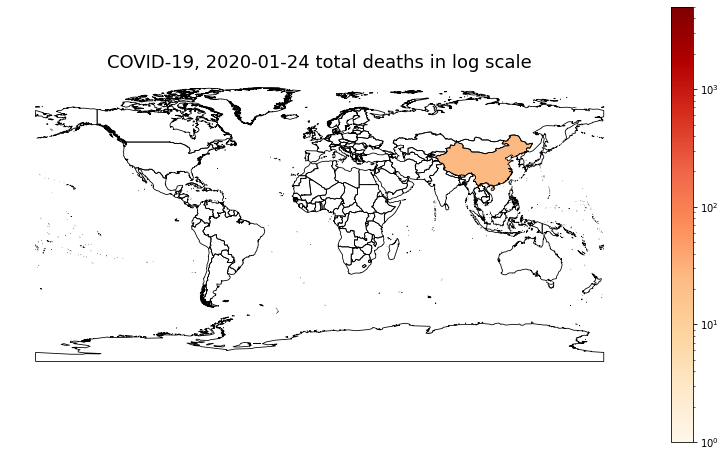

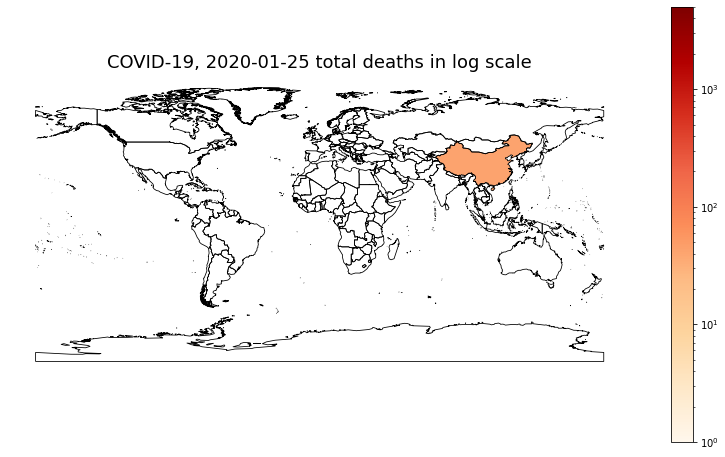

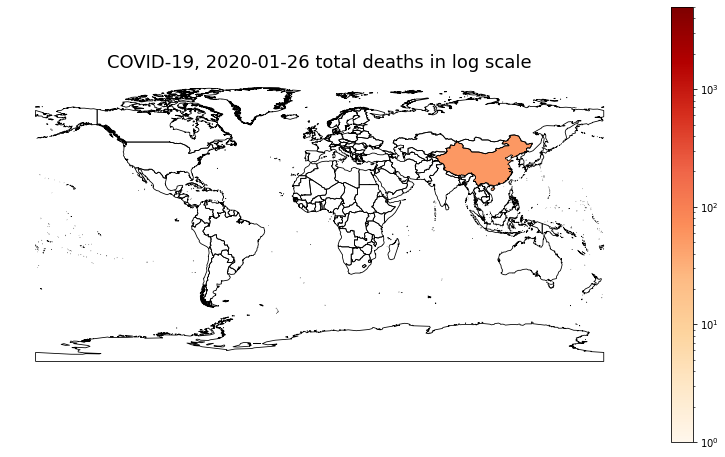

...

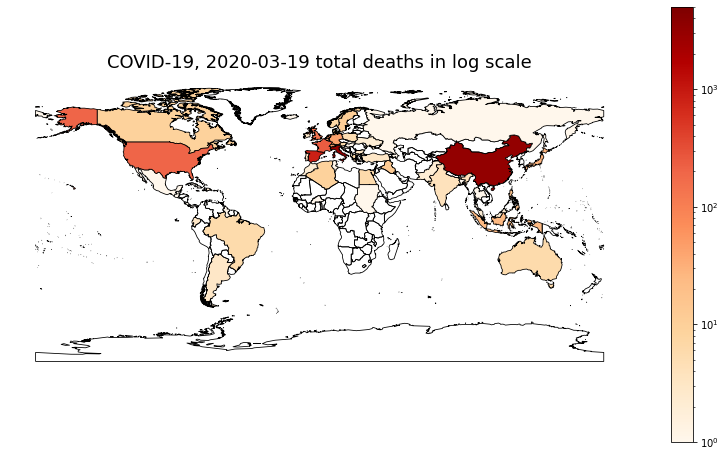

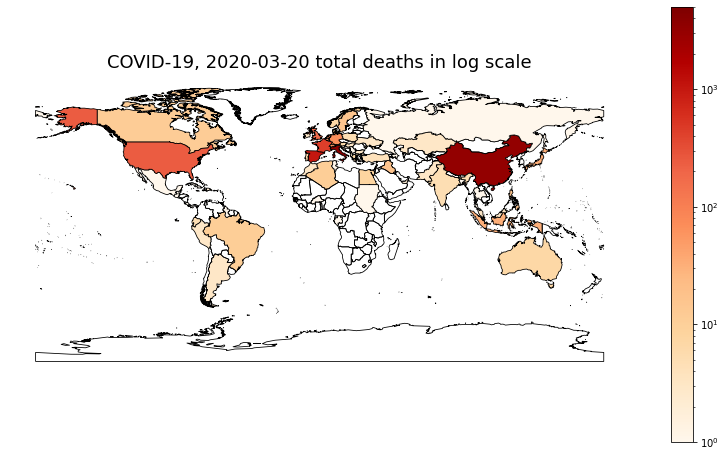

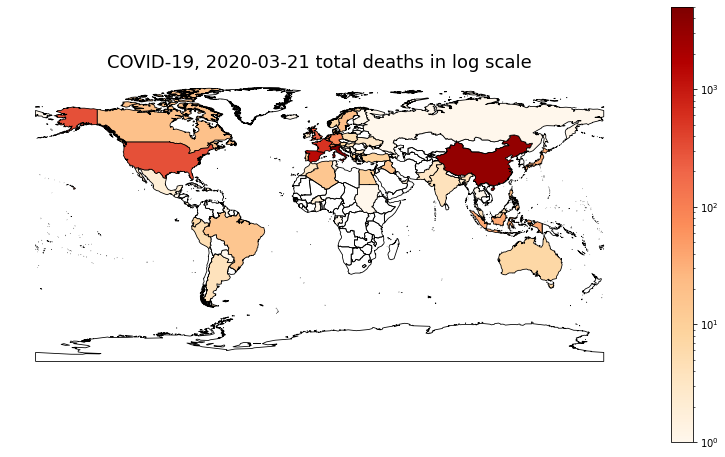

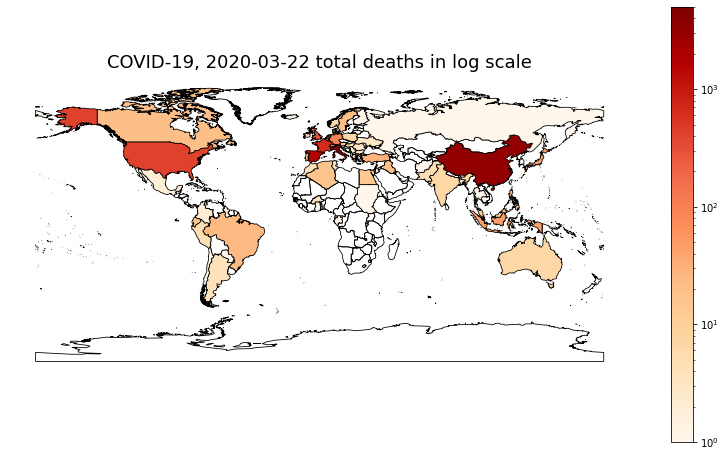

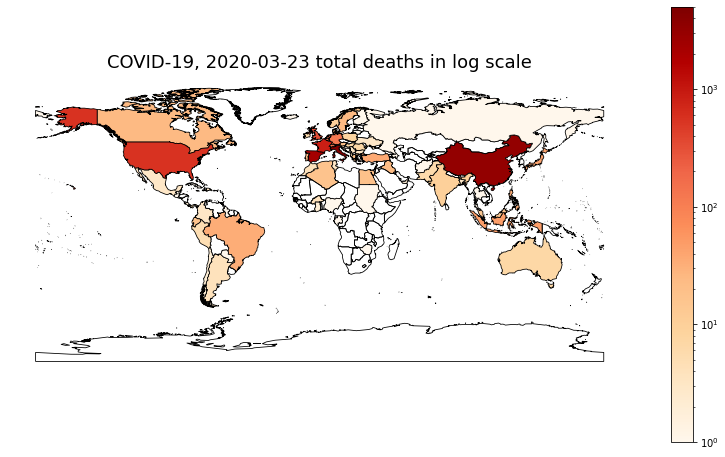

ValueError: ignored

In [185]:
for day in range(21, 90):
    data_deaths, key_deaths = get_dataset(df=deaths, day=day)
    fig, ax = plt.subplots(1, figsize=(14, 8))
    data_deaths.plot(column=key_deaths, cmap='OrRd', 
          linewidth=0.8, ax=ax, edgecolor='black', 
              legend=True, norm=mpl.colors.LogNorm(vmin=1, vmax=5000))
    
    ax.axis('off')
    ax.set_title('COVID-19, %s total deaths in log scale'%key_deaths, fontsize=18);
    pl.savefig("../figures/deaths/COVID-19-deaths-%s.png"%key_deaths)
    pl.show()
    pl.close(fig)

In [186]:
data_deaths.describe()

,2020-03-23
count,246.000000
mean,59.215447
std,466.818042
min,0.000000
25%,0.000000
50%,0.000000
75%,1.000000
max,6077.000000


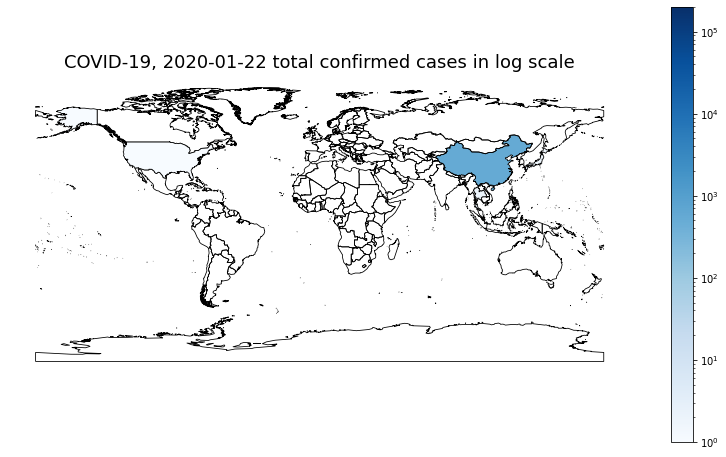

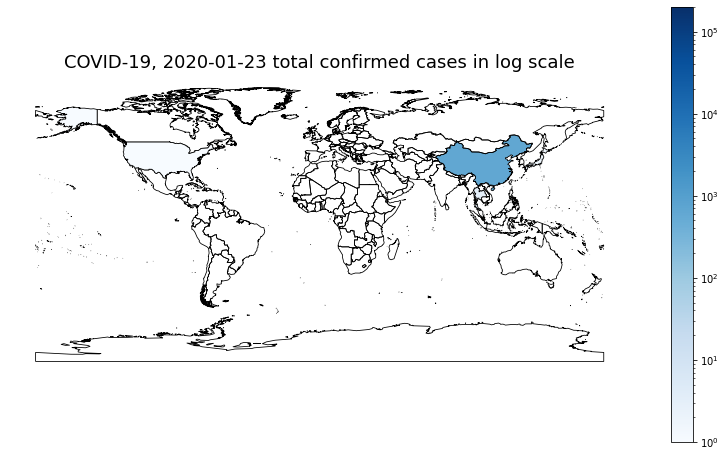

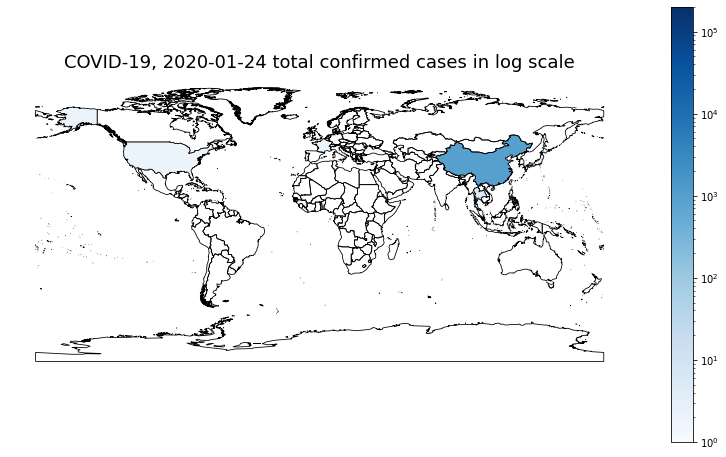

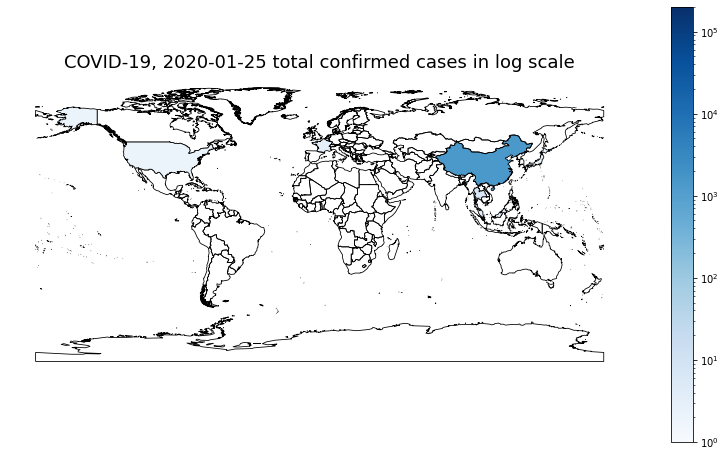

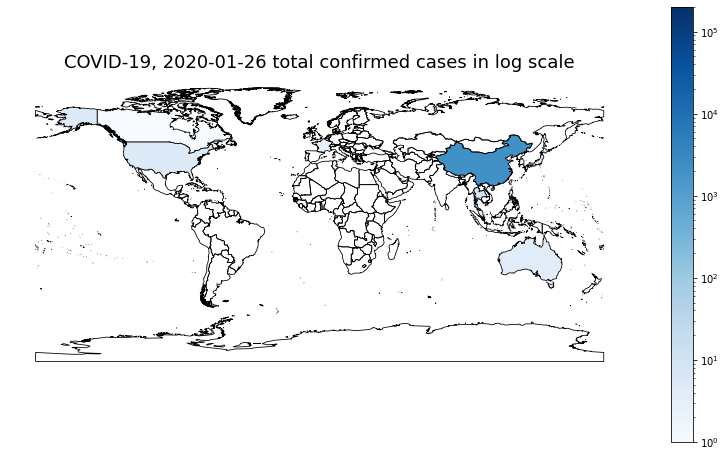

...

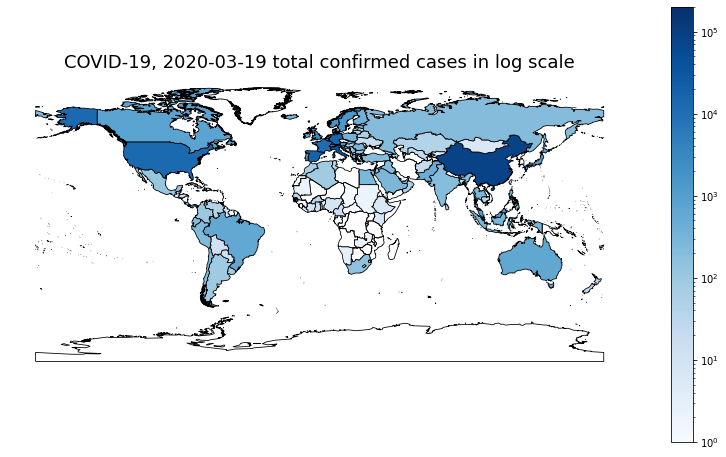

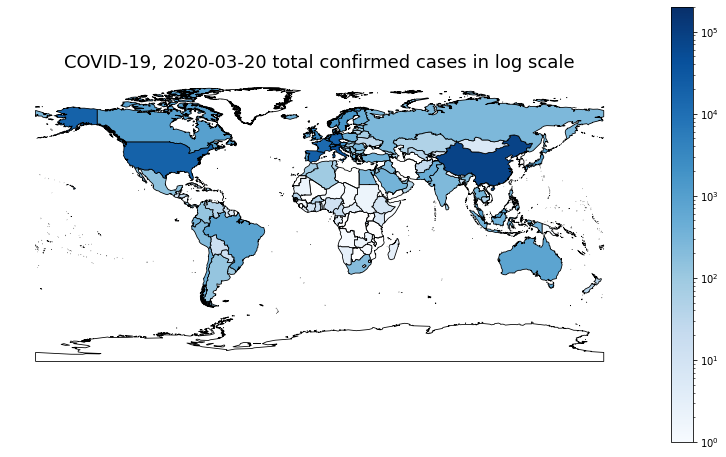

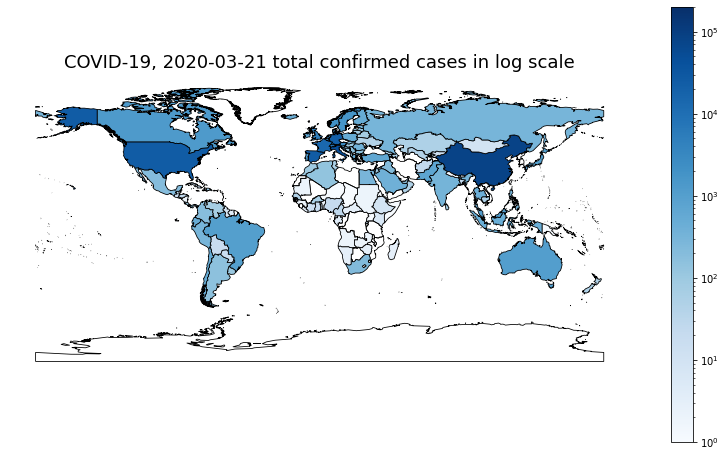

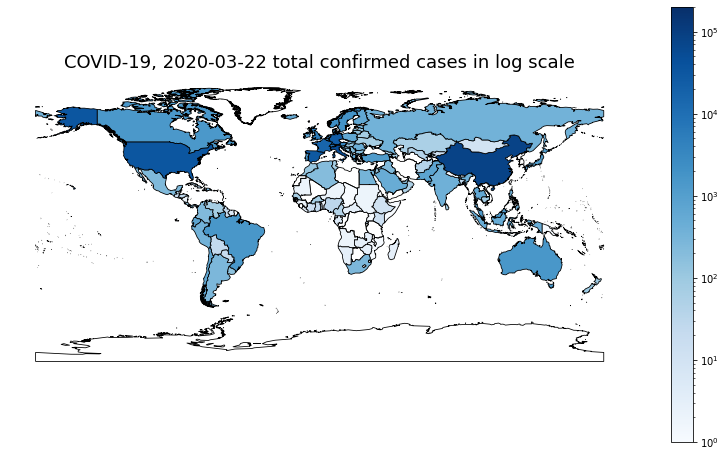

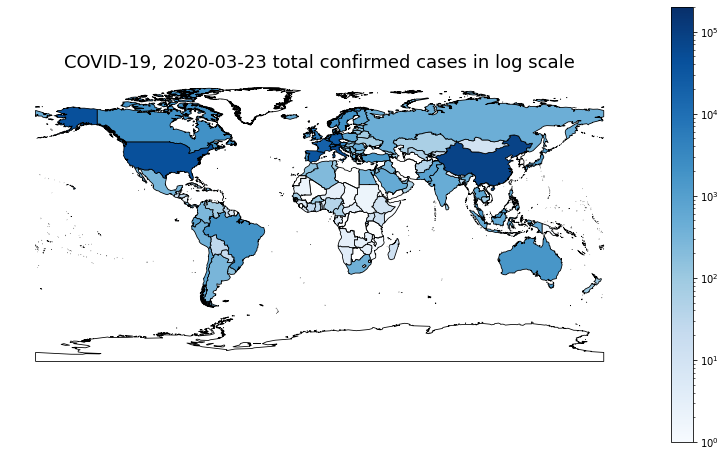

ValueError: ignored

In [187]:
for day in range(21, 90):
    data_confirmed, key_confirmed = get_dataset(df=confirmed, day=day)
    fig, ax = plt.subplots(1, figsize=(14, 8))
    data_confirmed.plot(column=key_confirmed, cmap='Blues', 
          linewidth=0.8, ax=ax, edgecolor='black', 
              legend=True, norm=mpl.colors.LogNorm(vmin=1, vmax=2e5))
    
    ax.axis('off')
    ax.set_title('COVID-19, %s total confirmed cases in log scale'%key_confirmed, fontsize=18);
    pl.savefig("../figures/confirmed/COVID-19-confirmed-%s.png"%key_confirmed)
    pl.show()
    pl.close(fig)

In [188]:
data_confirmed.describe()

,2020-03-23
count,246.000000
mean,1397.861789
std,7793.595795
min,0.000000
25%,0.000000
50%,4.000000
75%,184.500000
max,81498.000000


In [0]:
import cv2
import glob
import matplotlib.image as mpimg

In [190]:
img_array = []
file_list1 = sort( glob.glob('../figures/deaths/*.png') )

print( '%s relevant files found' %( len( file_list1 ) ) )


# Read all the images in the directories

for filename in file_list1 :

    img = cv2.imread( filename )
    height, width, layers = img.shape
    size = ( width, height )
    img_array.append( img )

# Start writing the images to videos

fourcc = cv2.VideoWriter_fourcc( *'GEOX' )

# Define the frame rate for video

fps = 5

# Define the video name and its extension

vid_name = file_list1[0][18:-4] + '-' + file_list1[-1][-14:-4] + \
'_' + str( fps ) + 'fps.mp4'

out = cv2.VideoWriter( vid_name, fourcc, fps, size )

print( 'Writing images to video file' )

for i, xx in enumerate(img_array) :
    #xxc = uint8( xx.copy() )
    out.write( xx )
out.release()

62 relevant files found
Writing images to video file


In [191]:
img_array = []
file_list2 = sort( glob.glob('../figures/confirmed/*.png') )

print( '%s relevant files found' %( len( file_list2 ) ) )


# Read all the images in the directories

for filename in file_list2 :

    img = cv2.imread( filename )
    height, width, layers = img.shape
    size = ( width, height )
    img_array.append( img )

# Start writing the images to videos

fourcc = cv2.VideoWriter_fourcc( *'GEOX' )

# Define the frame rate for video

fps = 5

# Define the video name and its extension

vid_name = file_list2[0][21:-4] + '-' + file_list2[-1][-14:-4] + \
'_' + str( fps ) + 'fps.mp4'

out = cv2.VideoWriter( vid_name, fourcc, fps, size )

print( 'Writing images to video file' )

for i, xx in enumerate(img_array) :
    #xxc = uint8( xx.copy() )
    out.write( xx )
out.release()

62 relevant files found
Writing images to video file


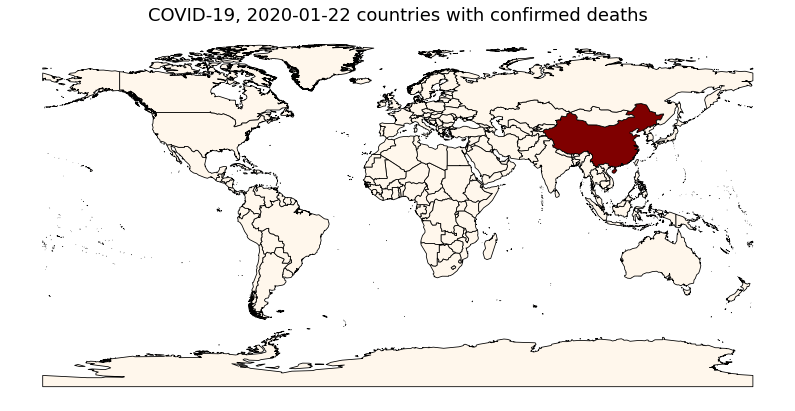

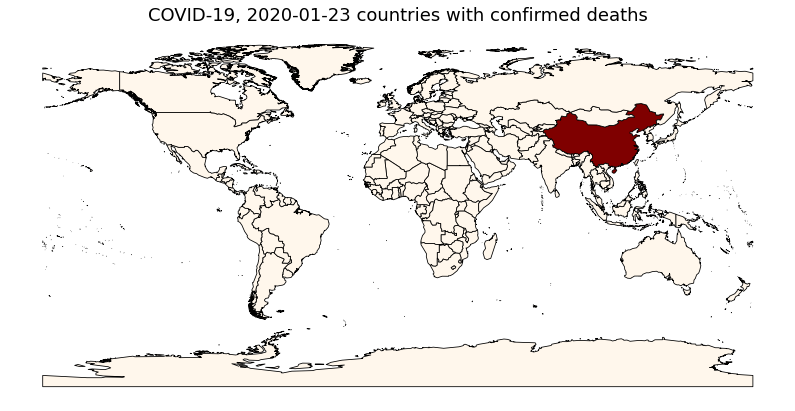

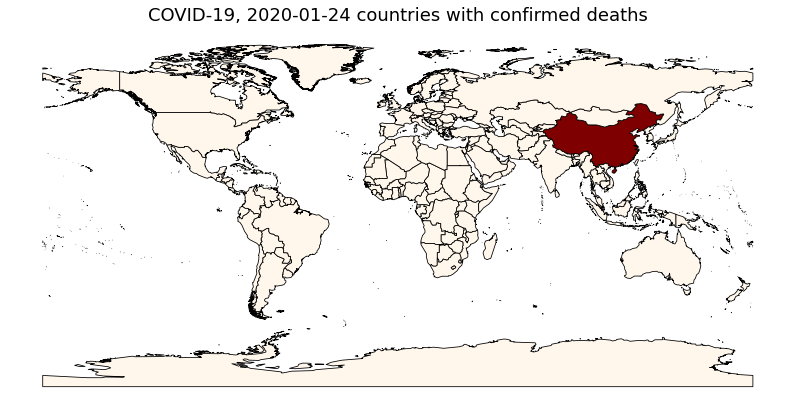

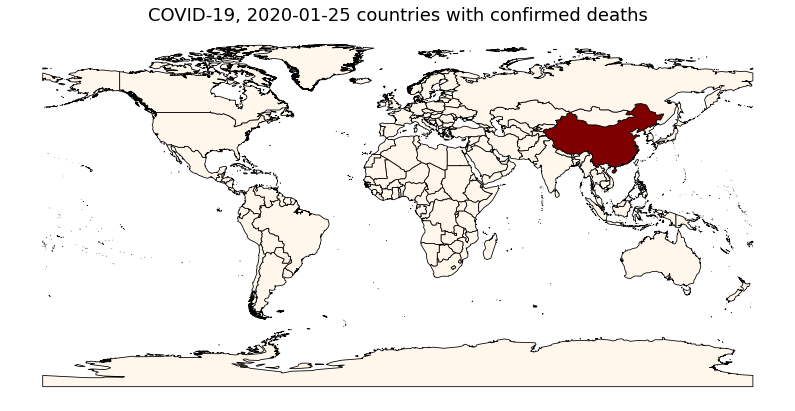

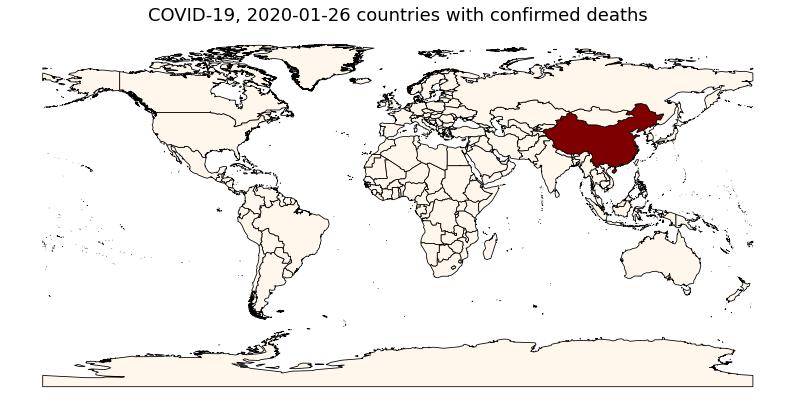

...

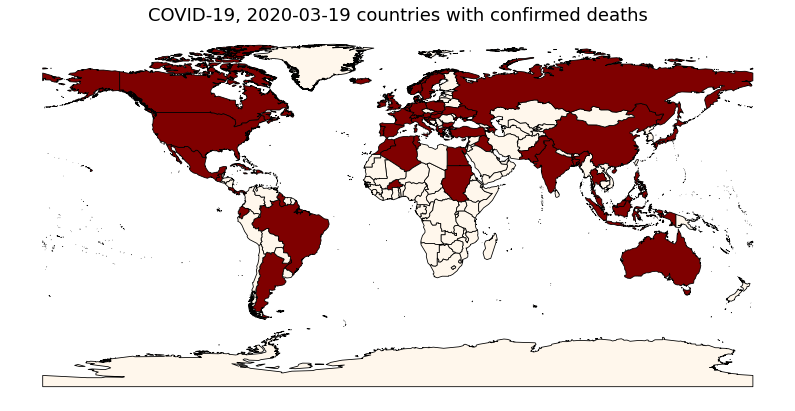

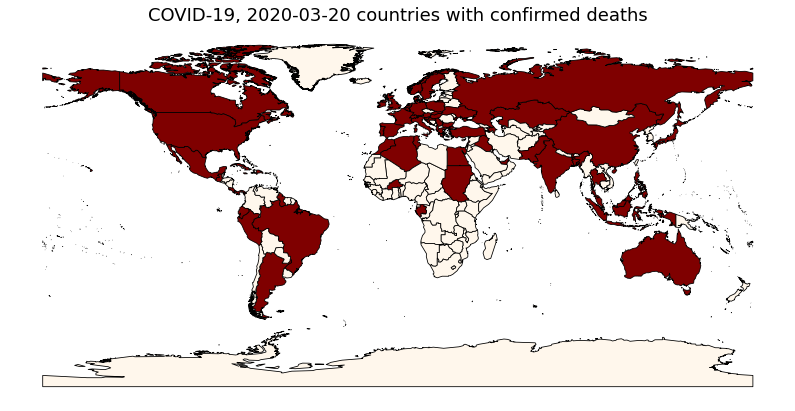

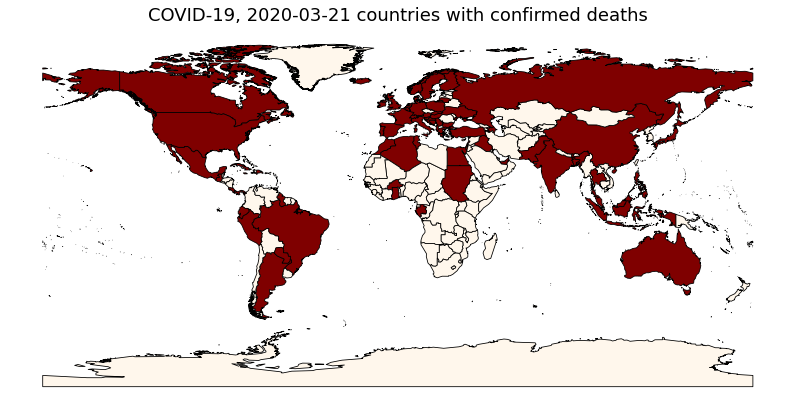

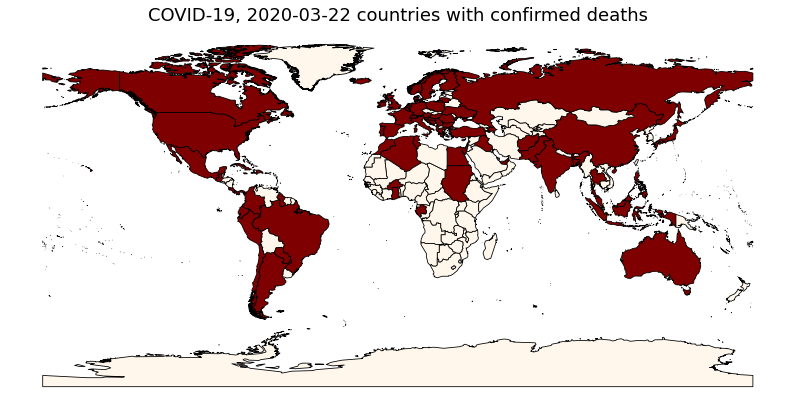

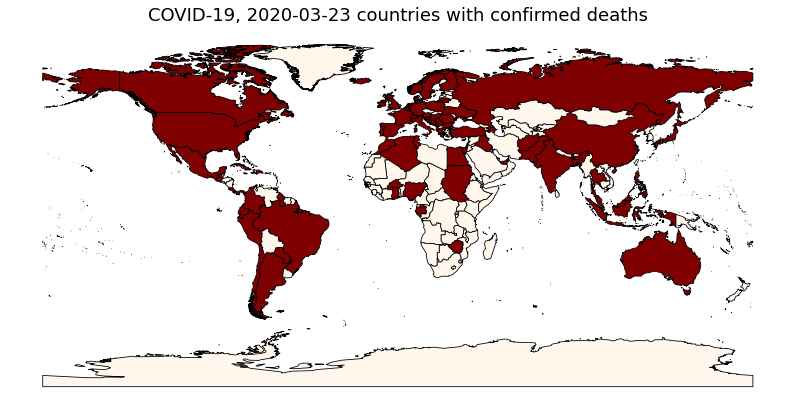

ValueError: ignored

In [193]:
for day in range(21,90):
    data_deaths,key_deaths = get_dataset(df=deaths, day=day)
    data_deaths["isit"] = data_deaths[key_deaths] > 0
    fig, ax = plt.subplots(1, figsize=(14, 8))
    data_deaths.plot(column="isit", cmap='OrRd', 
          linewidth=0.8, ax=ax, edgecolor='black', 
              vmin=0, vmax=1)
    
    ax.axis('off')
    ax.set_title('COVID-19, %s countries with confirmed deaths'%key_deaths, fontsize=18);
    pl.savefig("../figures/COVID-19-countireswdeath-%s.png"%key_deaths)
    pl.show()
    pl.close(fig)

In [196]:
img_array = []
file_list3 = sort( glob.glob('../figures/COVID-19-countireswdeath*.png') )

print( '%s relevant files found' %( len( file_list3 ) ) )


# Read all the images in the directories

for filename in file_list3 :

    img = cv2.imread( filename )
    height, width, layers = img.shape
    size = ( width, height )
    img_array.append( img )

# Start writing the images to videos

fourcc = cv2.VideoWriter_fourcc( *'GEOX' )

# Define the frame rate for video

fps = 5

# Define the video name and its extension

vid_name = file_list3[0][20:-4] + '-' + file_list3[-1][-14:-4] + \
'_' + str( fps ) + 'fps.mp4'

out = cv2.VideoWriter( vid_name, fourcc, fps, size )

print( 'Writing images to video file' )

for i, xx in enumerate(img_array) :
    #xxc = uint8( xx.copy() )
    out.write( xx )
out.release()

62 relevant files found
Writing images to video file


In [198]:
file_list3[-1][-14:-4]

'2020-03-23'

# COVID-19 infection analysis


In [0]:
# from the JHU database
infected = gpd.GeoDataFrame(pd.read_csv(root + 
                                        "time_series_covid19_confirmed_global.csv"))

In [0]:
infected = infected.groupby("Country/Region").sum()
# number of dates in the database
N = infected.shape[1] - 2

In [0]:
infected.reset_index(inplace=True)
infected["Country/Region"].replace("Mainland China", "China", inplace=True)
infected["Country/Region"].replace("UK", "United Kingdom", inplace=True)
infected["Country/Region"].replace("US", "United States", inplace=True)

In [203]:
infected.iloc[:,3:N+3]

,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,1/30/20,1/31/20,2/1/20,2/2/20,2/3/20,2/4/20,2/5/20,2/6/20,2/7/20,2/8/20,2/9/20,2/10/20,2/11/20,2/12/20,2/13/20,2/14/20,2/15/20,2/16/20,2/17/20,2/18/20,2/19/20,2/20/20,2/21/20,2/22/20,2/23/20,2/24/20,2/25/20,2/26/20,2/27/20,2/28/20,2/29/20,3/1/20,3/2/20,3/3/20,3/4/20,3/5/20,3/6/20,3/7/20,3/8/20,3/9/20,3/10/20,3/11/20,3/12/20,3/13/20,3/14/20,3/15/20,3/16/20,3/17/20,3/18/20,3/19/20,3/20/20,3/21/20,3/22/20,3/23/20
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,4,4,5,7,7,7,11,16,21,22,22,22,24,24,40,40
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,10,12,23,33,38,42,51,55,59,64,70,76,89,104
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,3,5,12,12,17,17,19,20,20,20,24,26,37,48,54,60,74,87,90,139,201,230
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,2,39,39,53,75,88,113,133
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,2,2,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
163,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,6,10,15,23,33,43,43,46
164,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,10,17,33,36,42,42,70,70,77
165,0,2,2,2,2,2,2,2,2,2,6,6,8,8,8,10,10,13,13,14,15,15,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,16,18,30,30,31,38,39,47,53,56,61,66,75,85,91,94,113,123
166,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,2,2,2,3,3


In [0]:
infected["totalinfected"] = infected[infected.columns[-1]]
infected = addlogbydate(infected)

data, key = get_dataset(day=24, df=infected)
data = gpd.GeoDataFrame(data.groupby("NAME").sum().reset_index(
    ).merge(data[["NAME", "geometry"]].drop_duplicates(subset="NAME"), 
            on="NAME", how="left"))#.plot()


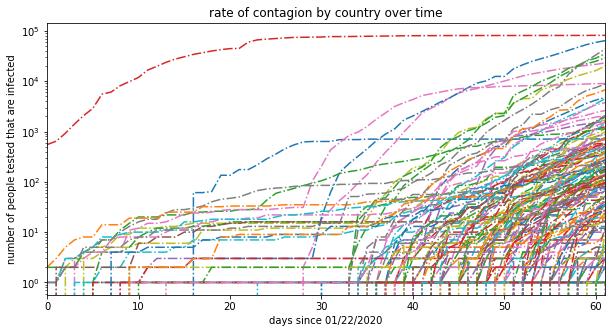

In [205]:
# the rate of contagion by country over time
def getcountry (df, country):
  return df[df["Country/Region"] == country].set_index("Country/Region")[
                  df.columns[3:N+3]].T.reset_index()

fig, ax = pl.subplots(1, 1, figsize=(10,5))
for country in infected["Country/Region"].values:

  tmp = getcountry(infected, country)#.set_index("Country/Region")
  tmp.plot(style="-.", 
           ax=ax, label=None,
           legend=False,
           #label=country, 
           figsize=(10,5))
pl.yscale("log")
pl.ylabel("number of people tested that are infected")
pl.xlabel("days since 01/22/2020")
pl.title("rate of contagion by country over time");

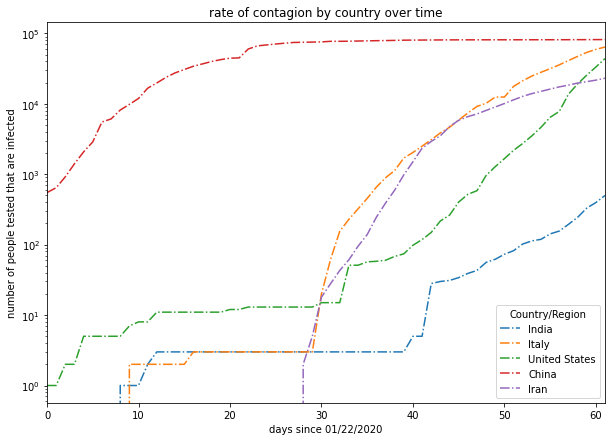

In [206]:
india = getcountry(infected, 'India')
italy = getcountry(infected, 'Italy')
us = getcountry(infected, 'United States')
china = getcountry(infected, 'China')
iran = getcountry(infected, 'Iran')

fig, ax = pl.subplots(1, 1, figsize=(10,7))

india.plot(style="-.", ax=ax,label='India', figsize=(10,7))
italy.plot(style="-.", ax=ax, label='Italy', figsize=(10,7))
us.plot(style="-.", ax=ax, label='US', figsize=(10,7))
china.plot(style="-.", ax=ax, label='China', figsize=(10,7))
iran.plot(style="-.", ax=ax, label='Iran', figsize=(10,7))


pl.yscale("log")
pl.ylabel("number of people tested that are infected")
pl.xlabel("days since 01/22/2020")
pl.title("rate of contagion by country over time");
#plt.figure()
#plt.plot(india)

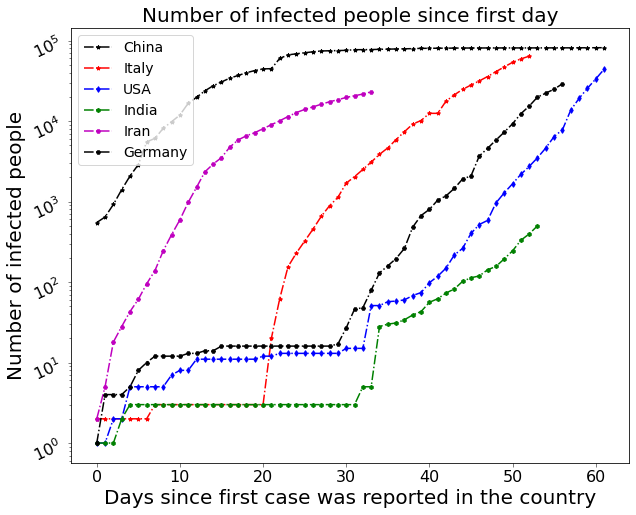

In [216]:
india = getcountry(infected, 'India')
italy = getcountry(infected, 'Italy')
us = getcountry(infected, 'United States')
china = getcountry(infected, 'China')
iran = getcountry(infected, 'Iran')
germany = getcountry(infected, 'Germany')

idx_itl = where( italy.Italy > 0 )[0]
idx_usa = where( us['United States'] > 0 )[0]
idx_ind = where( india.India > 0 )[0]
idx_irn = where( iran.Iran > 0 )[0]
idx_grn = where( germany.Germany > 0 )[0]

ls = '-.'
ms = 4

fig, ax = pl.subplots(1, 1, figsize=(10,8))

ax.plot( arange(len(idx_chn)), china.China[idx_chn],  'k*', label='China', ms=ms, ls=ls )
ax.plot( arange(len(idx_itl)), italy.Italy[idx_itl],  'r*', label='Italy', ms=ms, ls=ls )
ax.plot( arange(len(idx_usa)), us['United States'][idx_usa], 'bd', label='USA', ms=ms, ls=ls )
ax.plot( arange(len(idx_ind)), india.India[idx_ind], 'gh', label='India', ms=ms, ls=ls )
ax.plot( arange(len(idx_irn)), iran.Iran[idx_irn], 'mH', label='Iran', ms=ms, ls=ls )
ax.plot( arange(len(idx_grn)), germany.Germany[idx_grn], 'kH', label='Germany', ms=ms, ls=ls )

ax.set_ylabel('Number of infected people', fontsize=20)
ax.set_xlabel('Days since first case was reported in the country', fontsize=20)
ax.set_title('Number of infected people since first day', fontsize=20)
ax.set_yscale('log')

ax.get_xaxis().set_tick_params( which='both', direction='out',
labelbottom=True, bottom=True, width=.5, labelsize=16, labelrotation=0 )

ax.get_yaxis().set_tick_params( which='both', direction='out',
labelbottom=True, bottom=True, width=.5, labelsize=16, labelrotation=25 )

ax.legend(loc=2, fontsize=14);

In [217]:
idx_ind = where( india.India > 0 )[0]
len(idx_ind)

54

In [0]:
# combine with population data by country (using 2018 data from world bank)
df = infected.merge(pd.read_csv("pop.csv", skiprows=4)[[
                                                  "Country Name", "2018"]],
               left_on="Country/Region", right_on="Country Name")

In [219]:
output_notebook()

def bokeh_plot_ts(df, title='', p=None):
    """Plot bokeh map from GeoDF"""
    tmp = df.set_index("Country/Region")[df.columns[3:55]].T
    tmp["date"] = pd.to_datetime(tmp.index)
    tools = 'wheel_zoom,pan,reset,hover'
    if p is None: 
      p = figure(title=title,
                 plot_height=600, plot_width=600, 
               toolbar_location='right', tools=tools, 
               x_axis_type="datetime", y_axis_type="log")
    numlines = len(tmp.columns)
    mypalette = gray(numlines)
    colors = {}
    for i in range(numlines):
      colors[i] = mypalette[i]
    for i,(name, series) in enumerate(tmp.iteritems()):
      if name == 'date': continue
      name_for_display = np.tile(name, [len(tmp.index),1])

      source = ColumnDataSource({'x': tmp.date, 'y': series.values, 
              'series_name': name_for_display, 
              'Date': [tmp.date[i].strftime('%Y-%m-%d') for i in range(len(tmp))]})     
      p.line('x', 'y', source = source, line_alpha=0.3, line_width=3,
             line_color=colors[i], hover_line_alpha=1,)     

      hover = p.select(dict(type=HoverTool))
      hover.tooltips = [("Series", "@series_name"), 
                        ("Date", "@Date"),  
                        ("Value", "@y{0}"),]
      hover.mode = 'mouse'
    output_notebook()
    return p
tmp = infected.merge(#sort_values(by="totalinfected").merge(
    pd.read_csv("pop.csv", skiprows=4)[["Country Name", "2018"]],
               left_on="Country/Region", right_on="Country Name")

for i in range(len(tmp.index)):
  # normalize by population
  tmp.iloc[i, 3:N+3] = [0] + list(tmp.iloc[i,3+1:N+3].values - 
                                  tmp.iloc[i,3:N+2].values)
  tmp.iloc[i, 3:N+3] = tmp.iloc[i, 3:N+3].rolling(5, center=True,
                                                  min_periods=0).mean()
tmp
p = bokeh_plot_ts(tmp, title="daily rate of contagion (new cases) by country - " + 
                  "smoothed over a 5 days window"); 
show(p)

In [220]:
tmp = infected.merge(#sort_values(by="totalinfected").merge(
    pd.read_csv("pop.csv", skiprows=4)[["Country Name", "2018"]],
               left_on="Country/Region", right_on="Country Name")
tmp.head()

for i in range(len(tmp.index)):
  tmp.iloc[i, 3:N+3] = (np.array(tmp.iloc[i,3:N+3].values) / 
                        tmp.iloc[i]["2018"] * 1e6)
tmp
p = bokeh_plot_ts(tmp, title="infected per million people by country"); 
show(p)

# But the entire analysis is affected by the rate at which people are tested, and possibly by the test themselves: do all test kits have the same false positive and false negative rates?

# Adding number of tests by country

In [0]:
tests = pd.read_csv('covid-19-tests-country.csv')

In [222]:
tests = tests.replace("United States - CDC samples tested", "United States").replace(
    "China - Guangdong", "China").rename(
    {"Total COVID-19 tests performed (Tests)":"tests"}, axis=1)
tests

,Entity,Code,Year,Total COVID-19 tests
0,Armenia,ARM,57,813
1,Australia,AUS,59,113615
2,Australia - Australian Capital Territory,NaN,59,2062
3,Australia - New South Wales,NaN,58,39089
4,Australia - Queensland,NaN,58,27000
...,...,...,...,...
72,United Arab Emirates,ARE,55,125000
73,United Kingdom,GBR,58,64621
74,United States,USA,58,103945
75,United States,NaN,53,37646


out all the data together

In [0]:
infected["teninfected"] = [np.nan] * len(infected)
dates = []
for i,c in enumerate(infected.columns):
  if i > N+3:
    dates.append('')
    continue
  try: 
    dates.append(pd.to_datetime(c))
  except: 
    dates.append('')
dates = np.array(dates)

In [234]:
for c in infected["Country/Region"]:
  for day in range(0, 90):
    data = pd.DataFrame(infected[infected["Country/Region"] == c].T)
    if data[dates == (pd.to_datetime("01/01/2020") + 
                      pd.Timedelta(day, unit="days"))].values > 10:
      infected.loc[infected["Country/Region"] == c, ["teninfected"]] = day
      break


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:5: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  """


In [235]:
infected["teninfected"]

0      73.0
1      70.0
2      63.0
3      76.0
4       NaN
       ... 
163    77.0
164    75.0
165    38.0
166     NaN
167     NaN
Name: teninfected, Length: 168, dtype: float64

In [236]:
wtests = world[["NAME", "geometry"]].merge((infected[["Country/Region",
                      "totalinfected", "teninfected"]].merge(tests, left_on="Country/Region", 
                                       right_on="Entity").merge(
              deaths[['Country/Region', 'Lat', 'Long',
        'totaldeaths', 
        'firstoccurrence']], on="Country/Region")), how="left", 
        left_on="NAME",
        right_on="Country/Region").merge(pd.read_csv("pop.csv", 
                             skiprows=4)[["Country Name", "2017"]].rename(
                          {"2017":"pop"}, axis=1), left_on="Country/Region", 
                          right_on="Country Name")
print("number of countries with reported number of tests", wtests.shape[0])

number of countries with reported number of tests 50


In [239]:
wtests.keys()

Index(['NAME', 'geometry', 'Country/Region', 'totalinfected', 'teninfected',
       'Entity', 'Code', 'Year', 'Total COVID-19 tests', 'Lat', 'Long',
       'totaldeaths', 'firstoccurrence', 'Country Name', 'pop'],
      dtype='object')

In [0]:
# calculate tests per person and per million ppl, 
# death per 100,000 ppl, 
# ratio of dead to tested and infected to tested people
wtests["testspp"] = wtests["Total COVID-19 tests"] / wtests["pop"]
wtests["deathpM"] = wtests["totaldeaths"] / wtests["pop"] * 1e5
wtests["testspM"] = wtests["Total COVID-19 tests"] / wtests["pop"] * 1e3
wtests["dead2test"] = wtests["totaldeaths"] / wtests["Total COVID-19 tests"]
wtests["infected2test"] = wtests["totalinfected"] / wtests["Total COVID-19 tests"]
wtests["logtests"] = np.log(wtests["Total COVID-19 tests"] + 1)

In [323]:
wtests["totalinfected"]

0       194.0
1      1314.0
2       332.0
3      1593.0
4     81439.0
5       231.0
6       134.0
7      1514.0
8       906.0
9       326.0
10     3244.0
11      626.0
12    16044.0
13    24873.0
14      254.0
15      131.0
16      568.0
17      396.0
18     1071.0
19    59138.0
20     1086.0
21      139.0
22       76.0
23      131.0
24       90.0
25      251.0
26     1306.0
27     3401.0
28     4216.0
29     2383.0
30       66.0
31      776.0
32      634.0
33      245.0
34      494.0
35      433.0
36      380.0
37      274.0
38      414.0
39    28768.0
40     1934.0
41     7245.0
42      599.0
43     1236.0
44     5741.0
45       73.0
46    33276.0
47    33276.0
48      514.0
49      153.0
Name: totalinfected, dtype: float64

In [324]:
wtests["Total COVID-19 tests"]

0        813.0
1     113615.0
2      18645.0
3       2927.0
4     320000.0
5       4103.0
6       1039.0
7      10730.0
8       6600.0
9       2504.0
10     15613.0
11      3000.0
12     36747.0
13    167000.0
14      1264.0
15      3007.0
16      9189.0
17     14514.0
18     10864.0
19    206886.0
20     14901.0
21      3205.0
22     16000.0
23      1154.0
24       889.0
25       278.0
26     13876.0
27     18360.0
28      6000.0
29     43735.0
30       584.0
31      1979.0
32     13072.0
33      1455.0
34      8400.0
35      8284.0
36      1269.0
37      6438.0
38      9860.0
39     30000.0
40     14300.0
41      4000.0
42      7084.0
43      2900.0
44     64621.0
45       316.0
46    103945.0
47     37646.0
48      2028.0
49    125000.0
Name: Total COVID-19 tests, dtype: float64

In [93]:
16176.0/6628.0,33272.0/13624.0

(2.44055522027761, 2.4421608925425717)

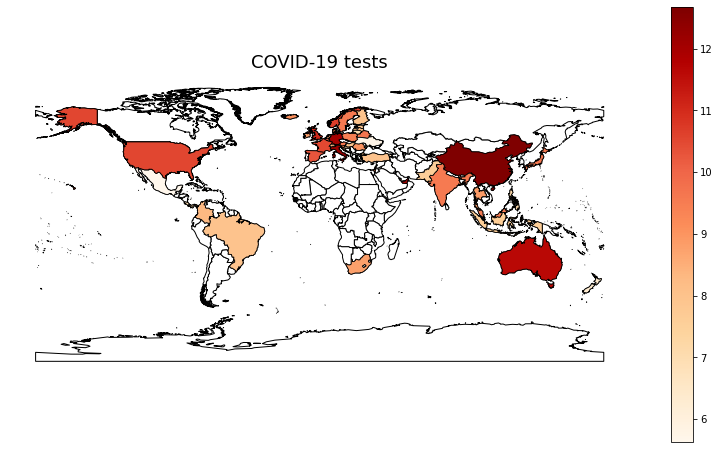

In [325]:
fig, ax = plt.subplots(1, figsize=(14, 8))
world.plot(ax=ax, edgecolor="k", facecolor="w")
wtests.fillna(0).plot(column="logtests", cmap="OrRd",
          linewidth=0.8, ax=ax, edgecolor='black',
          legend=True)
ax.axis('off')
ax.set_title('COVID-19 tests', fontsize=18);

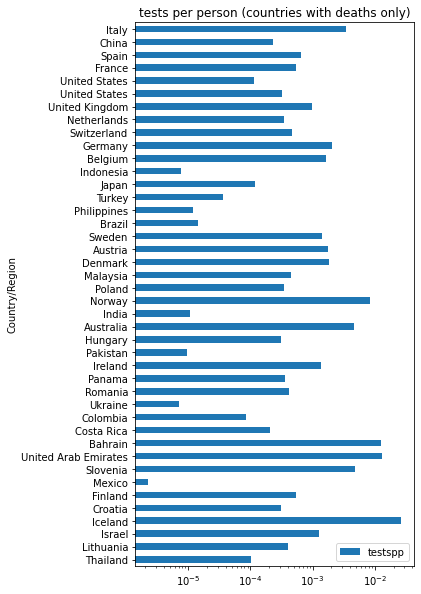

In [327]:
wtests[["testspp", "Country/Region", "totaldeaths"]][wtests.totaldeaths > 0
        ].sort_values(by="totaldeaths").set_index("Country/Region").plot(
            kind="barh", y="testspp", figsize=(5,10));
pl.title("tests per person (countries with deaths only)");
pl.xscale('log')

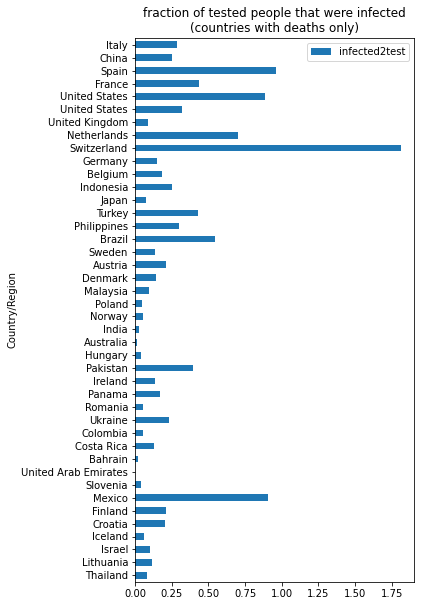

In [328]:
wtests[["infected2test", "Country/Region", "totaldeaths"]][wtests.totaldeaths > 0
        ].sort_values(by="totaldeaths").set_index("Country/Region").plot(
            kind="barh", y="infected2test", figsize=(5,10))
pl.title("fraction of tested people that were infected\n" + 
         "(countries with deaths only)");

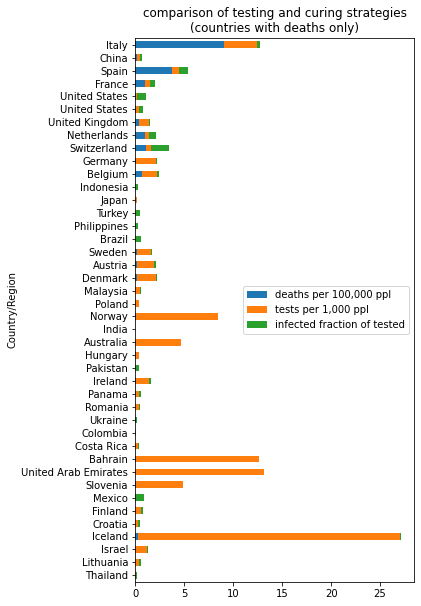

In [330]:
wtests[wtests.totaldeaths > 0
        ].sort_values(by="totaldeaths").set_index("Country/Region")[[
     "deathpM", "testspM", "infected2test"]].rename({"deathpM":
                                                     "deaths per 100,000 ppl", 
                            "infected2test":"infected fraction of tested", 
                            "testspM":"tests per 1,000 ppl"}, axis=1
         
     ).plot(kind="barh", stacked=True, figsize=(5,10))
pl.title("comparison of testing and curing strategies\n" +
         "(countries with deaths only)");
#pl.xscale('log')

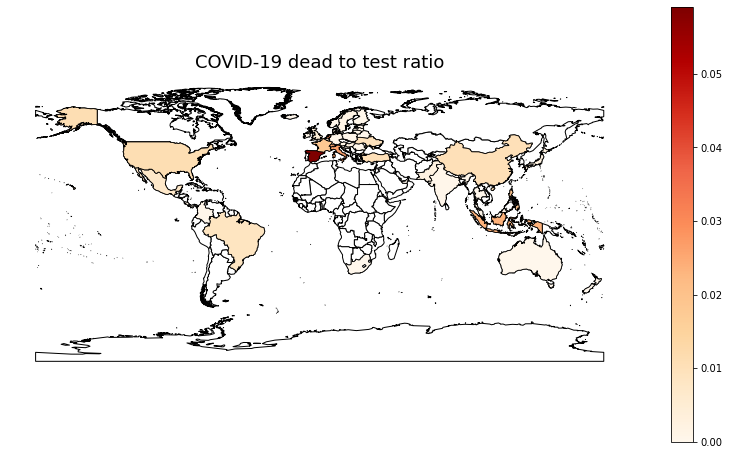

In [331]:
fig, ax = plt.subplots(1, figsize=(14, 8))
world.plot(ax=ax, edgecolor="k", facecolor="w")
wtests.fillna(0).plot(column="dead2test", cmap="OrRd",
          linewidth=0.8, ax=ax, edgecolor='black',
          legend=True)
ax.axis('off')
ax.set_title('COVID-19 dead to test ratio', fontsize=18);

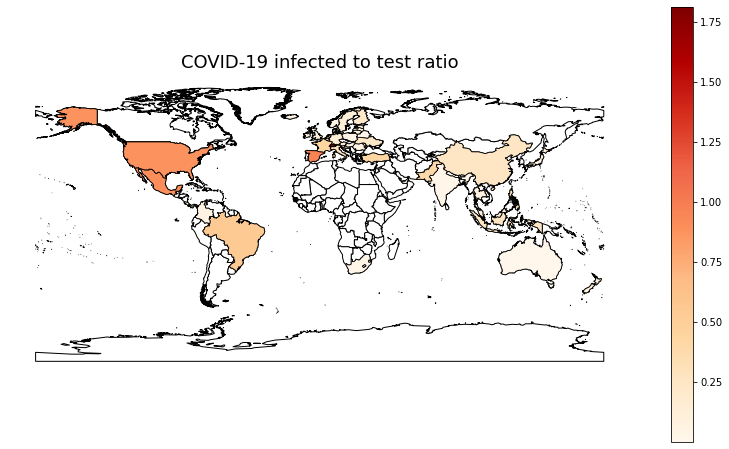

In [332]:
fig, ax = plt.subplots(1, figsize=(14, 8))
world.plot(ax=ax, edgecolor="k", facecolor="w")
wtests.fillna(0).plot(column="infected2test", cmap="OrRd",
          linewidth=0.8, ax=ax, edgecolor='black',
          legend=True)
ax.axis('off')
ax.set_title('COVID-19 infected to test ratio', fontsize=18);


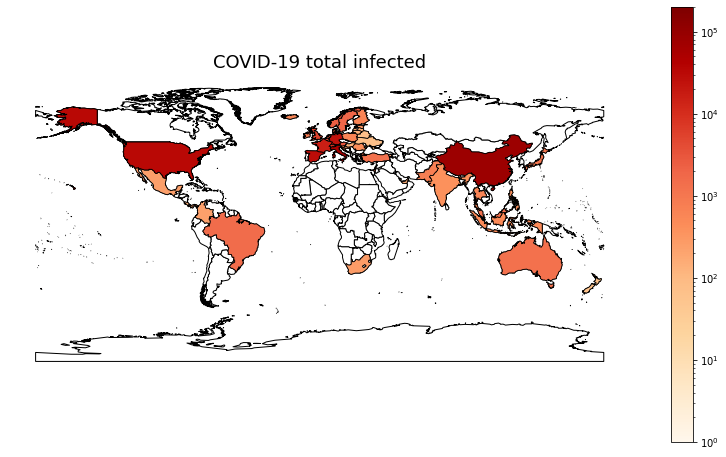

In [333]:
fig, ax = plt.subplots(1, figsize=(14, 8))
world.plot(ax=ax, edgecolor="k", facecolor="w")
wtests.fillna(0).plot(column="totalinfected", cmap="OrRd",
          linewidth=0.8, ax=ax, edgecolor='black',
          legend=True, norm=mpl.colors.LogNorm(vmin=1, vmax=2e5))
ax.axis('off')
ax.set_title('COVID-19 total infected', fontsize=18);


In [0]:
wtests.set_index("NAME", inplace=True)

In [335]:
wtests.index

Index(['Armenia', 'Australia', 'Bahrain', 'Brazil', 'China', 'Colombia',
       'Costa Rica', 'Denmark', 'Ireland', 'Estonia', 'Austria', 'Finland',
       'France', 'Germany', 'Croatia', 'Hungary', 'Iceland', 'India', 'Israel',
       'Italy', 'Japan', 'Latvia', 'Belarus', 'Lithuania', 'Malta', 'Mexico',
       'Malaysia', 'Belgium', 'Netherlands', 'Norway', 'New Zealand',
       'Pakistan', 'Poland', 'Panama', 'Qatar', 'Romania', 'Philippines',
       'South Africa', 'Slovenia', 'Spain', 'Sweden', 'Switzerland',
       'Thailand', 'Turkey', 'United Kingdom', 'Ukraine', 'United States',
       'United States', 'Indonesia', 'United Arab Emirates'],
      dtype='object', name='NAME')

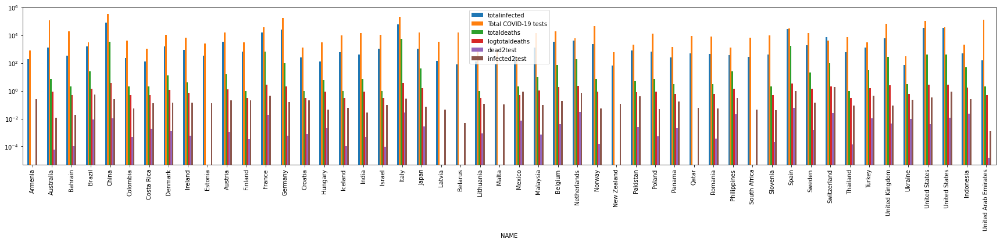

In [339]:
wtests[['totalinfected', 'Total COVID-19 tests', 'totaldeaths', 'logtotaldeaths',
       'dead2test', 'infected2test']][wtests.totalinfected > 0].plot(kind='bar',
                            figsize=(30, 5))
pl.yscale('log')

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:11: RuntimeWarning: divide by zero encountered in log10
  # This is added back by InteractiveShellApp.init_path()


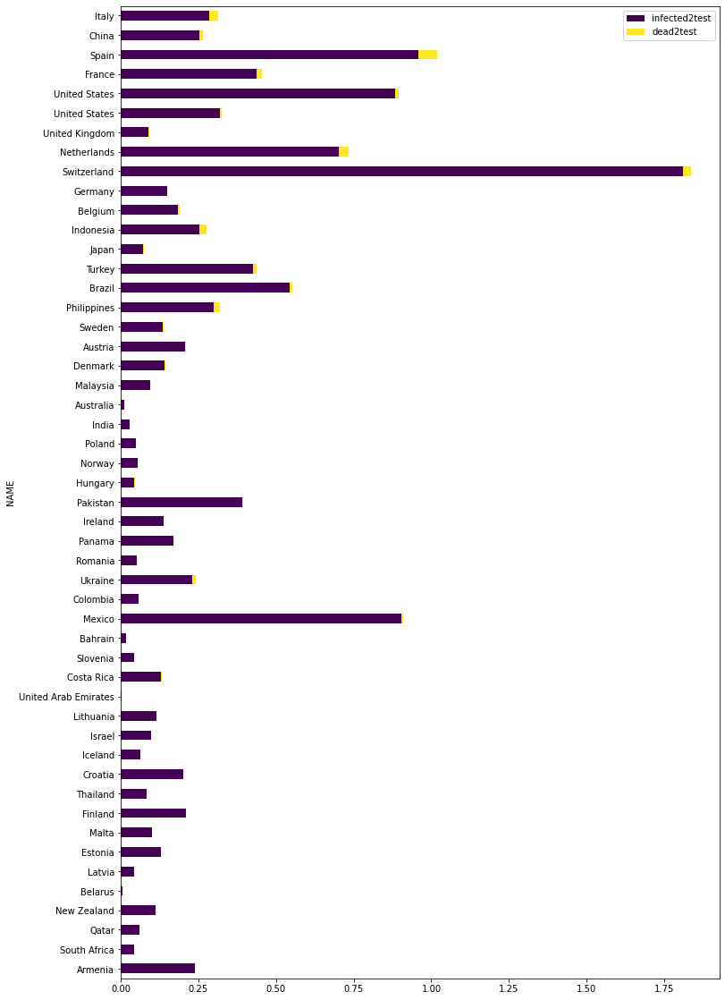

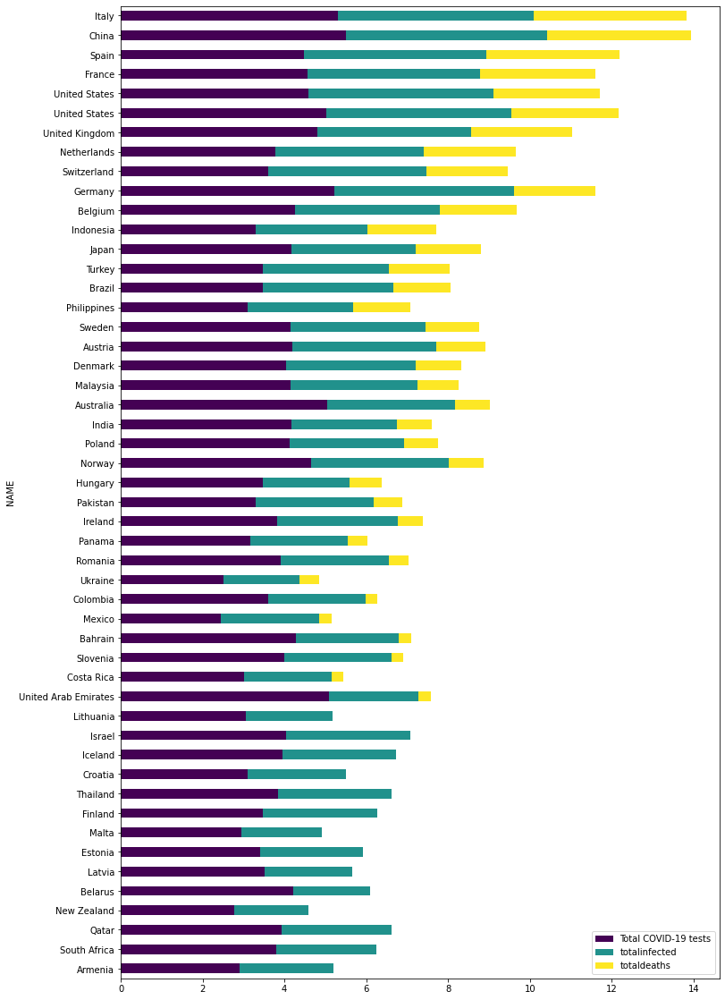

In [341]:
wtestsnormed = wtests[['Total COVID-19 tests', 
                       'totalinfected', 'totaldeaths',
                       'infected2test', 'dead2test', "teninfected"
       ]][wtests.totalinfected > 0].sort_values(by="totaldeaths", ascending=True)

wtestsnormed[[ 'infected2test', 'dead2test']].plot(kind='barh', 
                                figsize=(12, 20), stacked=True, 
                  cmap='viridis')

np.log10(wtestsnormed[['Total COVID-19 tests', 
                       'totalinfected', 'totaldeaths']]).plot(kind='barh', 
                                figsize=(12, 20), stacked=True, 
                  cmap='viridis');

In [342]:
wtestsnormed

,Total COVID-19 tests,totalinfected,totaldeaths,infected2test,dead2test,teninfected
NAME,,,,,,
Armenia,813.0,194.0,0.0,0.238622,0.000000,73.0
South Africa,6438.0,274.0,0.0,0.042560,0.000000,70.0
Qatar,8400.0,494.0,0.0,0.058810,0.000000,67.0
New Zealand,584.0,66.0,0.0,0.113014,0.000000,76.0
Belarus,16000.0,76.0,0.0,0.004750,0.000000,71.0
Latvia,3205.0,139.0,0.0,0.043370,0.000000,72.0
Estonia,2504.0,326.0,0.0,0.130192,0.000000,69.0
Malta,889.0,90.0,0.0,0.101237,0.000000,72.0
Finland,3000.0,626.0,1.0,0.208667,0.000333,64.0


In [343]:
socioec = pd.read_csv("gdp.csv", 
                      skiprows=4)[["Country Name", "2017"]].rename(
                          {"2017":"gdp"}, axis=1).merge(
                          pd.read_csv("pop.csv", 
                             skiprows=4)[["Country Name", "2017"]].rename(
                          {"2017":"pop"}, axis=1)).merge(
                          pd.read_csv("pop.csv",skiprows=4)[[
                          "Country Name", "2017"]].rename(
                          {"2017":"growth"}, axis=1)).merge(
                          pd.read_csv("land.csv",skiprows=4)[[
                          "Country Name", "2017"]].rename(
                          {"2017":"land"}, axis=1)).merge(
                          pd.read_csv("urban.csv",skiprows=4)[[
                          "Country Name", "2010"]].rename(
                          {"2010":"urban"}, axis=1)).merge(
                          pd.read_csv("age.csv",skiprows=4)[[
                          "Country Name", "2018"]].rename(
                          {"2018":"age"}, axis=1)).fillna(0)
socioec

,Country Name,gdp,pop,growth,land,urban,age
0,Aruba,2.700559e+09,105366.0,105366.0,180.0,172.847748,13.550947
1,Afghanistan,2.019176e+10,36296400.0,36296400.0,652860.0,0.000000,2.584927
2,Angola,1.221238e+11,29816748.0,29816748.0,1246700.0,1427.029541,2.216374
3,Albania,1.302506e+10,2873457.0,2873457.0,27400.0,1689.403809,13.744736
4,Andorra,3.013387e+09,77001.0,77001.0,470.0,0.000000,0.000000
...,...,...,...,...,...,...,...
259,Kosovo,7.227700e+09,1830700.0,1830700.0,10887.0,0.000000,0.000000
260,"Yemen, Rep.",2.681870e+10,27834821.0,27834821.0,527970.0,4703.399902,2.876270
261,South Africa,3.495541e+11,57000451.0,57000451.0,1213090.0,53460.312500,5.318005
262,Zambia,2.586814e+10,16853688.0,16853688.0,743390.0,0.000000,2.099678


In [344]:
# for the urban fraction of population, the 2010 data is more complete
pd.read_csv("urban.csv",skiprows=4)[["2010"]]

,2010
0,172.847748
1,NaN
2,1427.029541
3,1689.403809
4,NaN
...,...
259,NaN
260,4703.399902
261,53460.312500
262,NaN


In [345]:
formodeling = wtestsnormed.merge(socioec, left_index=True, right_on="Country Name")
formodeling.head()

,Total COVID-19 tests,totalinfected,totaldeaths,infected2test,dead2test,teninfected,Country Name,gdp,pop,growth,land,urban,age
8,813.0,194.0,0.0,0.238622,0.0,73.0,Armenia,1.152746e+10,2944809.0,2944809.0,2.847000e+04,0.000000,11.253818
261,6438.0,274.0,0.0,0.042560,0.0,70.0,South Africa,3.495541e+11,57000451.0,57000451.0,1.213090e+06,53460.312500,5.318005
198,8400.0,494.0,0.0,0.058810,0.0,67.0,Qatar,1.669286e+11,2724724.0,2724724.0,1.161000e+04,1495.149292,1.370070
178,584.0,66.0,0.0,0.113014,0.0,76.0,New Zealand,2.025908e+11,4793900.0,4793900.0,2.633100e+05,8116.299805,15.652425
23,16000.0,76.0,0.0,0.004750,0.0,71.0,Belarus,5.472660e+10,9498264.0,9498264.0,2.029880e+05,7783.031738,14.845148


In [0]:
formodeling["testpp"] = formodeling["Total COVID-19 tests"] / formodeling["pop"]
#formodeling["totaldeaths"] = formodeling["test"] / formodeling["pop"]
#formodeling["testpp"] = formodeling["test"] / formodeling["pop"]
formodeling.reset_index(inplace=True)

cannot predict the numner of tests from socioeconomics at all. R~0.2

In [348]:
import statsmodels.formula.api as smf
testpp = smf.ols(formula="testpp ~ gdp + pop + growth + " + 
                 "land + urban + age", data=formodeling).fit()
testpp.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                 testpp   R-squared:                       0.068
Model:                            OLS   Adj. R-squared:                 -0.037
Method:                 Least Squares   F-statistic:                    0.6465
Date:                Tue, 24 Mar 2020   Prob (F-statistic):              0.666
Time:                        23:56:47   Log-Likelihood:                 201.26
No. Observations:                  50   AIC:                            -390.5
Df Residuals:                      44   BIC:                            -379.0
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.0046      0.002      2.457      0.018       0.001       0.008
gdp          6.98e-16   8.56e-16      0.815      0.419   -1.03e-15    2.42e-15
pop         1.717e-10   7.02e-11      2.446      0.018    3.02e-11    3.13e-10
growth     -1.744e-10   7.09e-11     -2.459      0.018   -3.17e-10   -3.15e-11
land       -2.808e-11   4.54e-10     -0.062      0.951   -9.43e-10    8.87e-10
urban      -1.869e-08   2.16e-08     -0.867      0.391   -6.22e-08    2.48e-08
age           -0.0001      0.000     -1.264      0.213      -0.000    8.73e-05
==============================================================================
Omnibus:                       73.081   Durbin-Watson:                   2.111
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              793.590
Skew:                           3.879   Prob(JB):                    4.72e-173
Kurtosis:                      20.909   Cond. No.                     9.45e+19
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.1e-13. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

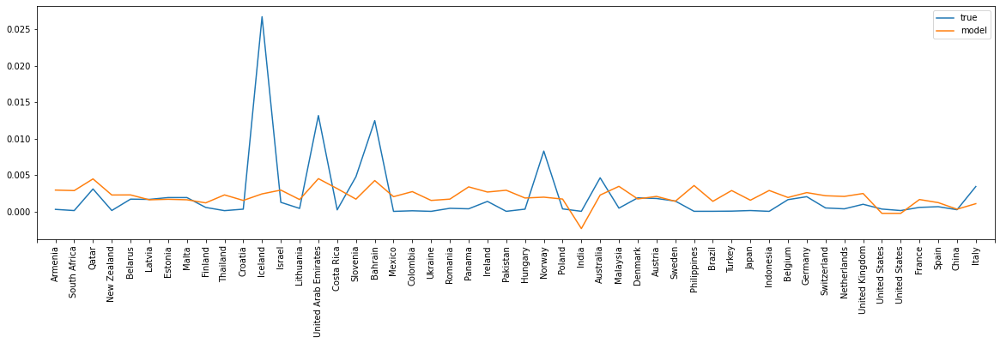

In [353]:
ax = formodeling[["testpp"]].plot(y="testpp",
                                  label="true", figsize=(20,5))
pl.plot(testpp.predict(), label="model")
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + 
                   list(formodeling["Country Name"].values), rotation=90);
pl.legend();

The total number of infected individuals can be predicted to R~0.9 with dgb, land area, and urban fraction strong correlations. Urban fraction is again inversely proportional, but it improves the fit from 65 to 90%

In [354]:
totalinfected = smf.ols(formula="totalinfected ~ gdp +	pop	+ growth + " + 
                        "land	+ age", data=formodeling).fit()
totalinfected.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          totalinfected   R-squared:                       0.521
Model:                            OLS   Adj. R-squared:                  0.478
Method:                 Least Squares   F-statistic:                     12.23
Date:                Tue, 24 Mar 2020   Prob (F-statistic):           8.23e-07
Time:                        23:58:48   Log-Likelihood:                -535.17
No. Observations:                  50   AIC:                             1080.
Df Residuals:                      45   BIC:                             1090.
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept  -5955.0015   4408.171     -1.351      0.183   -1.48e+04    2923.510
gdp         1.818e-09   6.71e-10      2.712      0.009    4.68e-10    3.17e-09
pop           -0.0001      0.000     -1.267      0.212      -0.000    8.06e-05
growth         0.0002      0.000      1.435      0.158   -6.36e-05       0.000
land          -0.0002      0.001     -0.142      0.888      -0.002       0.002
age          508.2886    272.482      1.865      0.069     -40.517    1057.095
==============================================================================
Omnibus:                       41.857   Durbin-Watson:                   0.629
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              190.931
Skew:                           2.056   Prob(JB):                     3.47e-42
Kurtosis:                      11.645   Cond. No.                     1.74e+20
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 3.26e-14. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

In [355]:
totalinfected = smf.ols(formula="totalinfected ~ gdp +	pop	+ growth + " + 
                        "land	+ urban + age", data=formodeling).fit()
totalinfected.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          totalinfected   R-squared:                       0.607
Model:                            OLS   Adj. R-squared:                  0.562
Method:                 Least Squares   F-statistic:                     13.59
Date:                Tue, 24 Mar 2020   Prob (F-statistic):           4.99e-08
Time:                        23:58:49   Log-Likelihood:                -530.22
No. Observations:                  50   AIC:                             1072.
Df Residuals:                      44   BIC:                             1084.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept  -2238.3200   4211.751     -0.531      0.598   -1.07e+04    6249.906
gdp         7.506e-09   1.93e-09      3.883      0.000    3.61e-09    1.14e-08
pop        -7.451e-05      0.000     -0.470      0.640      -0.000       0.000
growth      9.528e-05      0.000      0.595      0.555      -0.000       0.000
land           0.0003      0.001      0.308      0.759      -0.002       0.002
urban         -0.1510      0.049     -3.103      0.003      -0.249      -0.053
age          257.6357    262.336      0.982      0.331    -271.068     786.339
==============================================================================
Omnibus:                       56.499   Durbin-Watson:                   0.740
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              457.054
Skew:                           2.734   Prob(JB):                    5.65e-100
Kurtosis:                      16.765   Cond. No.                     9.45e+19
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.1e-13. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

the total number of deaths is actually predicted farily well by the land area, and urban area, but it is inversely proportional to the urban area. The data on urban area is likely strongly based. Adding the tests per person does not improve the fit. GDP is mildely predictive. Adding the total number of infected people makes the death prediction ~90% accurate with **Italy being a strong outlier**

In [356]:
totaldeaths = smf.ols(formula="totaldeaths ~ gdp +	pop	+ growth	+ " + 
                      "land	+ urban + age", data=formodeling).fit()
totaldeaths.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            totaldeaths   R-squared:                       0.209
Model:                            OLS   Adj. R-squared:                  0.119
Method:                 Least Squares   F-statistic:                     2.329
Date:                Tue, 24 Mar 2020   Prob (F-statistic):             0.0583
Time:                        23:58:50   Log-Likelihood:                -405.74
No. Observations:                  50   AIC:                             823.5
Df Residuals:                      44   BIC:                             834.9
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   -265.2813    349.316     -0.759      0.452    -969.281     438.718
gdp         2.232e-10    1.6e-10      1.392      0.171   -9.99e-11    5.46e-10
pop        -9.468e-06   1.31e-05     -0.721      0.475   -3.59e-05     1.7e-05
growth      1.064e-05   1.33e-05      0.801      0.427   -1.61e-05    3.74e-05
land        6.345e-06    8.5e-05      0.075      0.941      -0.000       0.000
urban         -0.0053      0.004     -1.314      0.196      -0.013       0.003
age           26.4390     21.758      1.215      0.231     -17.411      70.289
==============================================================================
Omnibus:                       88.289   Durbin-Watson:                   0.751
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1722.822
Skew:                           4.841   Prob(JB):                         0.00
Kurtosis:                      30.078   Cond. No.                     9.45e+19
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.1e-13. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

In [357]:
# the number of tested people per capita actually does not improve the fit
totaldeaths = smf.ols(formula="totaldeaths ~ gdp +	pop	+ growth	+ " + 
                      "land	+ urban + age + testpp", data=formodeling).fit()
totaldeaths.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            totaldeaths   R-squared:                       0.209
Model:                            OLS   Adj. R-squared:                  0.119
Method:                 Least Squares   F-statistic:                     2.329
Date:                Tue, 24 Mar 2020   Prob (F-statistic):             0.0583
Time:                        23:58:51   Log-Likelihood:                -405.74
No. Observations:                  50   AIC:                             823.5
Df Residuals:                      44   BIC:                             834.9
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   -265.2682    349.308     -0.759      0.452    -969.253     438.717
gdp         2.232e-10    1.6e-10      1.392      0.171   -9.99e-11    5.46e-10
pop         -9.48e-06   1.32e-05     -0.721      0.475    -3.6e-05     1.7e-05
growth      1.065e-05   1.33e-05      0.801      0.427   -1.61e-05    3.74e-05
land        6.344e-06    8.5e-05      0.075      0.941      -0.000       0.000
urban         -0.0053      0.004     -1.314      0.196      -0.013       0.003
age           26.4384     21.758      1.215      0.231     -17.411      70.288
testpp        -1.2204      1.605     -0.760      0.451      -4.455       2.014
==============================================================================
Omnibus:                       88.289   Durbin-Watson:                   0.751
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1722.833
Skew:                           4.841   Prob(JB):                         0.00
Kurtosis:                      30.078   Cond. No.                     9.45e+19
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.1e-13. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

In [0]:
formodeling["teninfected"].fillna(maxday.days, inplace=True)

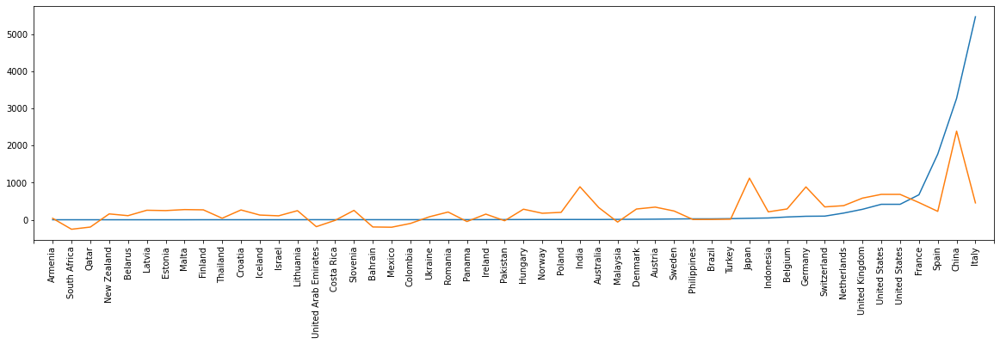

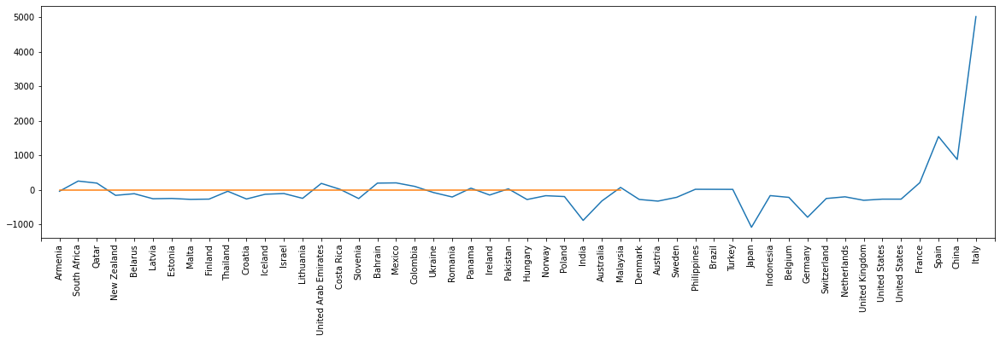

In [361]:
import numpy as np
ax = formodeling["totaldeaths"].plot(figsize=(20,5))
pl.plot(totaldeaths.predict())
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.figure()
ax = (formodeling["totaldeaths"] - totaldeaths.predict()).plot(figsize=(20,5))
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.plot([0,30], [0,0]);

In [362]:
totaldeaths = smf.ols(formula="totaldeaths ~ gdp + " + 
                          " testpp + "
                      "pop	+ growth	+ land	+ urban + age + totalinfected", 
                      data=formodeling).fit()
totaldeaths.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            totaldeaths   R-squared:                       0.901
Model:                            OLS   Adj. R-squared:                  0.887
Method:                 Least Squares   F-statistic:                     65.03
Date:                Tue, 24 Mar 2020   Prob (F-statistic):           5.85e-20
Time:                        23:59:38   Log-Likelihood:                -353.86
No. Observations:                  50   AIC:                             721.7
Df Residuals:                      43   BIC:                             735.1
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept       -91.6781    125.595     -0.730      0.469    -344.965     161.609
gdp            -3.59e-10   6.66e-11     -5.392      0.000   -4.93e-10   -2.25e-10
testpp           -0.4257      0.583     -0.730      0.469      -1.601       0.750
pop           -1.389e-07   1.79e-07     -0.777      0.442      -5e-07    2.22e-07
growth        -3.047e-07   1.38e-07     -2.209      0.033   -5.83e-07   -2.65e-08
land          -1.815e-05   3.05e-05     -0.596      0.555   -7.96e-05    4.33e-05
urban             0.0064      0.002      4.014      0.000       0.003       0.010
age               6.4572      7.883      0.819      0.417      -9.440      22.355
totalinfected     0.0776      0.004     17.307      0.000       0.069       0.087
==============================================================================
Omnibus:                       27.214   Durbin-Watson:                   1.390
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              101.547
Skew:                           1.222   Prob(JB):                     8.90e-23
Kurtosis:                       9.540   Cond. No.                     1.62e+20
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 3.76e-14. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

In [363]:
logtotaldeaths1 = smf.ols(formula="np.log10(totaldeaths +1)~ gdp + " + 
                          " testpp + "
                      "pop	+ growth	+ land	+ urban + age + totalinfected", 
                      data=formodeling).fit()
logtotaldeaths1.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                OLS Regression Results                               
=====================================================================================
Dep. Variable:     np.log10(totaldeaths + 1)   R-squared:                       0.619
Model:                                   OLS   Adj. R-squared:                  0.565
Method:                        Least Squares   F-statistic:                     11.62
Date:                       Tue, 24 Mar 2020   Prob (F-statistic):           1.07e-07
Time:                               23:59:39   Log-Likelihood:                -46.071
No. Observations:                         50   AIC:                             106.1
Df Residuals:                             43   BIC:                             119.5
Df Model:                                  6                                         
Covariance Type:                   nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept         0.4883      0.266      1.833      0.074      -0.049       1.026
gdp            4.585e-14   1.41e-13      0.325      0.747   -2.39e-13    3.31e-13
testpp            0.0023      0.001      1.827      0.075      -0.000       0.005
pop           -5.021e-10   3.79e-10     -1.323      0.193   -1.27e-09    2.63e-10
growth         4.032e-10   2.93e-10      1.378      0.175   -1.87e-10    9.93e-10
land          -9.059e-09   6.47e-08     -0.140      0.889   -1.39e-07    1.21e-07
urban         -3.682e-07   3.39e-06     -0.109      0.914    -7.2e-06    6.47e-06
age               0.0193      0.017      1.154      0.255      -0.014       0.053
totalinfected  4.351e-05   9.51e-06      4.577      0.000    2.43e-05    6.27e-05
==============================================================================
Omnibus:                        3.234   Durbin-Watson:                   0.708
Prob(Omnibus):                  0.199   Jarque-Bera (JB):                2.719
Skew:                           0.460   Prob(JB):                        0.257
Kurtosis:                       2.322   Cond. No.                     1.62e+20
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 3.76e-14. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

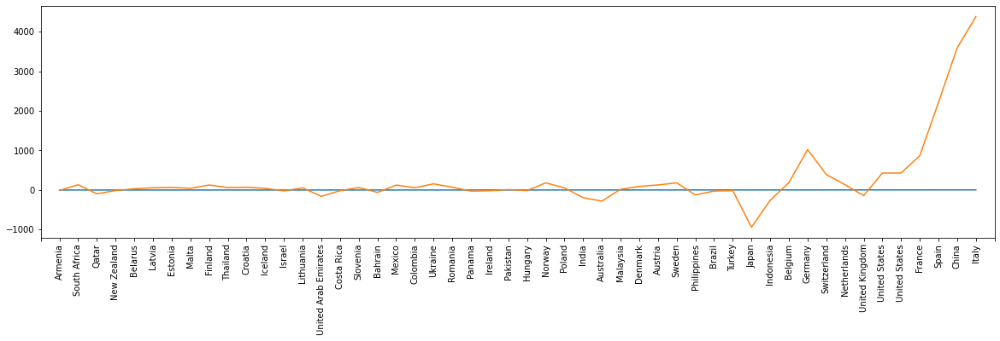

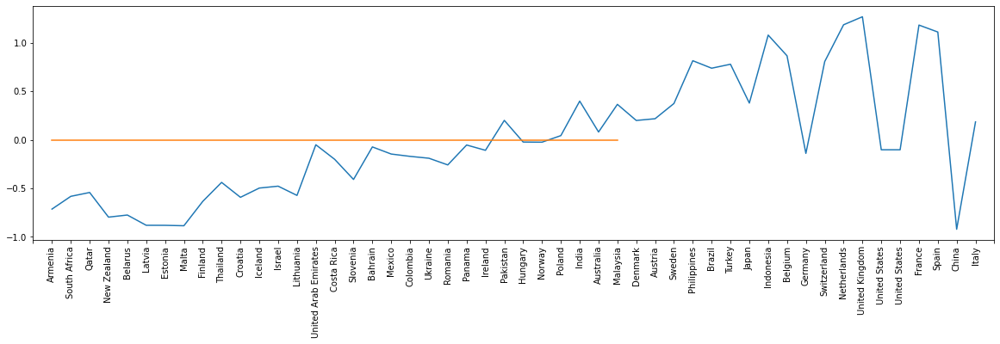

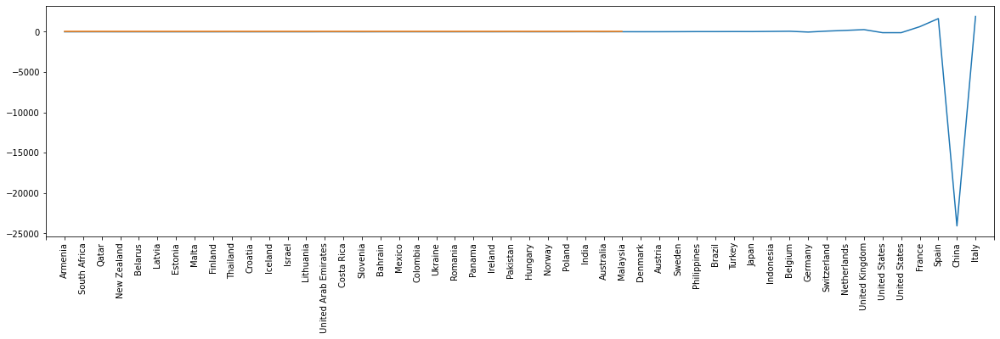

In [365]:
ax = np.log10(formodeling["totaldeaths"] + 1).plot(figsize=(20,5))
pl.plot(totaldeaths.predict())
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.figure()
ax = (np.log10(formodeling["totaldeaths"] + 1) - logtotaldeaths1.predict()).plot(figsize=(20,5))
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.plot([0,30], [0,0]);
pl.figure()
ax = ((formodeling["totaldeaths"]) - 10**logtotaldeaths1.predict()).plot(figsize=(20,5))
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.plot([0,30], [0,0]);

In [366]:
totaldeaths2 = smf.ols(formula="totaldeaths ~ gdp + " + 
                      "pop	+ growth	+ land	+ urban + age + totalinfected +"
                      "testpp + teninfected", 
                      data=formodeling).fit()
totaldeaths2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            totaldeaths   R-squared:                       0.901
Model:                            OLS   Adj. R-squared:                  0.885
Method:                 Least Squares   F-statistic:                     54.75
Date:                Wed, 25 Mar 2020   Prob (F-statistic):           4.46e-19
Time:                        00:00:02   Log-Likelihood:                -353.73
No. Observations:                  50   AIC:                             723.5
Df Residuals:                      42   BIC:                             738.8
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept        40.2923    311.031      0.130      0.898    -587.393     667.978
gdp            -3.76e-10   7.66e-11     -4.910      0.000   -5.31e-10   -2.21e-10
pop            1.093e-06   1.03e-05      0.106      0.916   -1.96e-05    2.18e-05
growth        -1.542e-06   1.03e-05     -0.150      0.882   -2.23e-05    1.93e-05
land          -2.078e-05   3.13e-05     -0.664      0.510   -8.39e-05    4.23e-05
urban             0.0068      0.002      3.770      0.001       0.003       0.010
age               6.4239      7.956      0.807      0.424      -9.632      22.480
totalinfected     0.0774      0.005     17.070      0.000       0.068       0.087
testpp            0.3681      2.849      0.129      0.898      -5.382       6.118
teninfected      -2.0703      4.456     -0.465      0.645     -11.063       6.922
==============================================================================
Omnibus:                       25.181   Durbin-Watson:                   1.361
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               95.156
Skew:                           1.088   Prob(JB):                     2.17e-21
Kurtosis:                       9.398   Cond. No.                     9.48e+19
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.09e-13. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

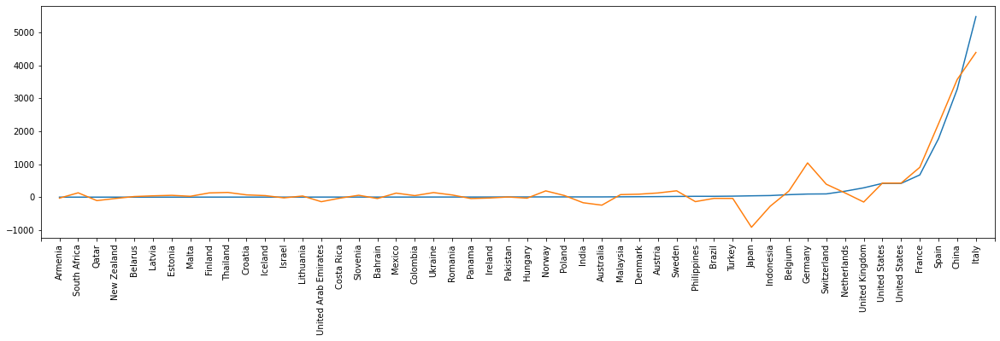

<Figure size 432x288 with 0 Axes>

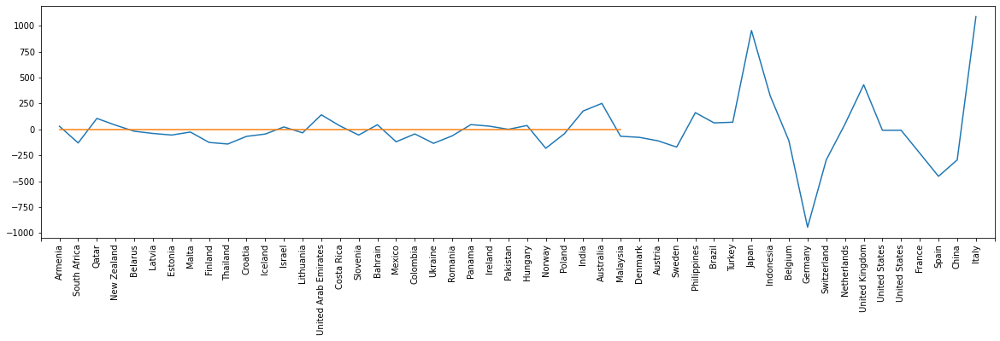

In [367]:
ax = formodeling["totaldeaths"].plot(figsize=(20,5))
pl.plot(totaldeaths2.predict())
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.figure()
pl.figure()
ax = ((formodeling["totaldeaths"]) - totaldeaths2.predict()).plot(figsize=(20,5))
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.plot([0,30], [0,0]);

In [368]:
logtotaldeaths2 = smf.ols(formula="np.log10(totaldeaths + 1) ~ gdp + " + 
                      "pop	+ growth	+ land	+ urban + age + totalinfected +"
                      "testpp + teninfected", 
                      data=formodeling).fit()
totaldeaths2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            totaldeaths   R-squared:                       0.901
Model:                            OLS   Adj. R-squared:                  0.885
Method:                 Least Squares   F-statistic:                     54.75
Date:                Wed, 25 Mar 2020   Prob (F-statistic):           4.46e-19
Time:                        00:00:15   Log-Likelihood:                -353.73
No. Observations:                  50   AIC:                             723.5
Df Residuals:                      42   BIC:                             738.8
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept        40.2923    311.031      0.130      0.898    -587.393     667.978
gdp            -3.76e-10   7.66e-11     -4.910      0.000   -5.31e-10   -2.21e-10
pop            1.093e-06   1.03e-05      0.106      0.916   -1.96e-05    2.18e-05
growth        -1.542e-06   1.03e-05     -0.150      0.882   -2.23e-05    1.93e-05
land          -2.078e-05   3.13e-05     -0.664      0.510   -8.39e-05    4.23e-05
urban             0.0068      0.002      3.770      0.001       0.003       0.010
age               6.4239      7.956      0.807      0.424      -9.632      22.480
totalinfected     0.0774      0.005     17.070      0.000       0.068       0.087
testpp            0.3681      2.849      0.129      0.898      -5.382       6.118
teninfected      -2.0703      4.456     -0.465      0.645     -11.063       6.922
==============================================================================
Omnibus:                       25.181   Durbin-Watson:                   1.361
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               95.156
Skew:                           1.088   Prob(JB):                     2.17e-21
Kurtosis:                       9.398   Cond. No.                     9.48e+19
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.09e-13. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

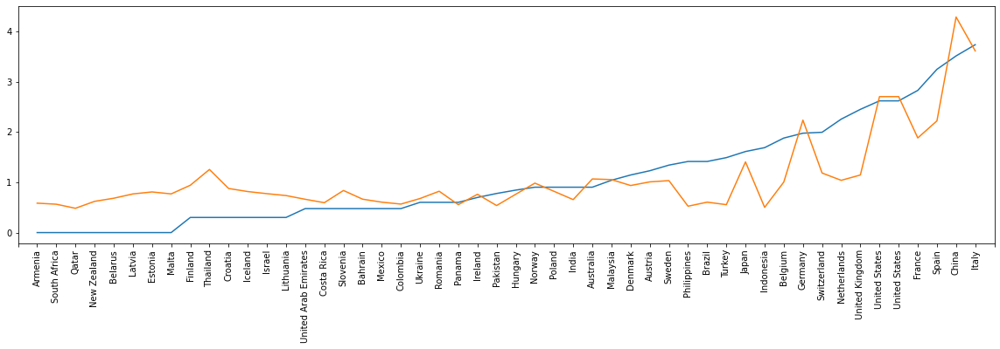

<Figure size 432x288 with 0 Axes>

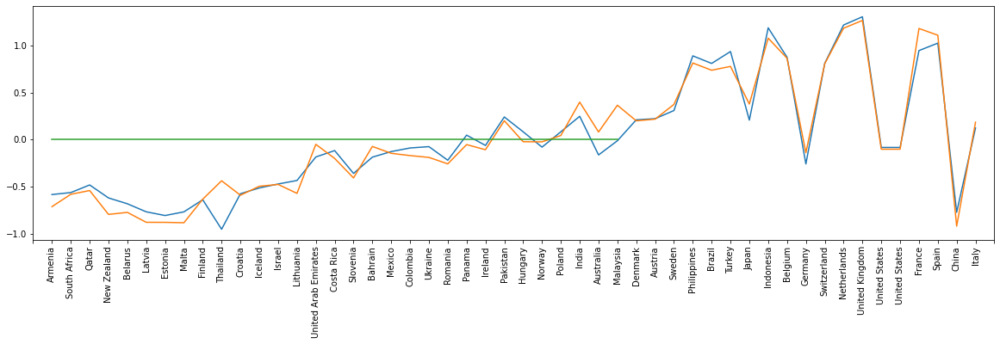

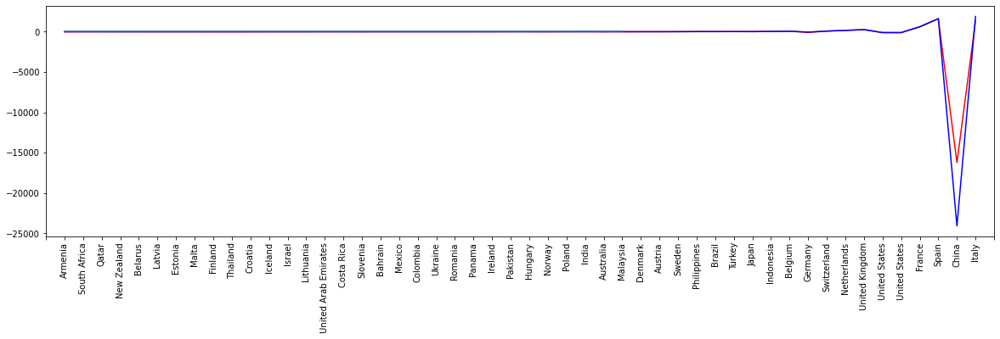

In [370]:
ax = np.log10(formodeling["totaldeaths"] + 1).plot(figsize=(20,5))
pl.plot(logtotaldeaths2.predict())
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.figure()
pl.figure()
ax = (np.log10(formodeling["totaldeaths"] + 1) - logtotaldeaths2.predict()).plot(figsize=(20,5))
(np.log10(formodeling["totaldeaths"] + 1) - logtotaldeaths1.predict()).plot(ax=ax)
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.plot([0,30], [0,0]);
pl.figure()
ax = (formodeling["totaldeaths"] - 10**logtotaldeaths2.predict()).plot(c='r', figsize=(20,5))
(formodeling["totaldeaths"] - 10**logtotaldeaths1.predict()).plot(ax=ax, c='b')
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.plot([0,30], [0,0]);

In [371]:
import sklearn
from sklearn import ensemble
from sklearn.ensemble import RandomForestRegressor
RandomForestRegressor
y = np.log10(formodeling[["totaldeaths"]] + 1)
features = ["gdp","pop","growth","land","urban","age","totalinfected",
                "testpp","teninfected"]
X = formodeling[features]
regr = RandomForestRegressor(max_depth=4, random_state=0)
regr.fit(X, y)
print(regr.feature_importances_);
print(regr.predict(X));

[0.07391935 0.01950413 0.02187875 0.0137526  0.0300956  0.01068046
 0.80842839 0.01336308 0.00837765]
[0.17634537 0.38655893 0.28732364 0.26195885 0.28334807 0.13086289
 0.13997696 0.1138494  0.43724776 0.62450166 0.29445604 0.34543769
 0.59966579 0.23447333 0.44868934 0.33988458 0.33190654 0.35977183
 0.78338508 0.44171639 0.4850426  0.52850399 0.33440797 0.61789995
 0.93908387 0.52948451 0.97522791 0.83182703 1.03782827 1.04337439
 1.01510449 1.02580645 1.35679413 1.18614182 0.99453462 1.34102095
 1.34484257 1.36930708 1.32284194 1.73541395 2.36898623 2.0409033
 2.10308274 2.34353918 2.67517806 2.67517806 2.75928804 2.95333421
 3.20939795 3.34096439]


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


In [372]:
regr.score(X, y)

0.9563436865333194

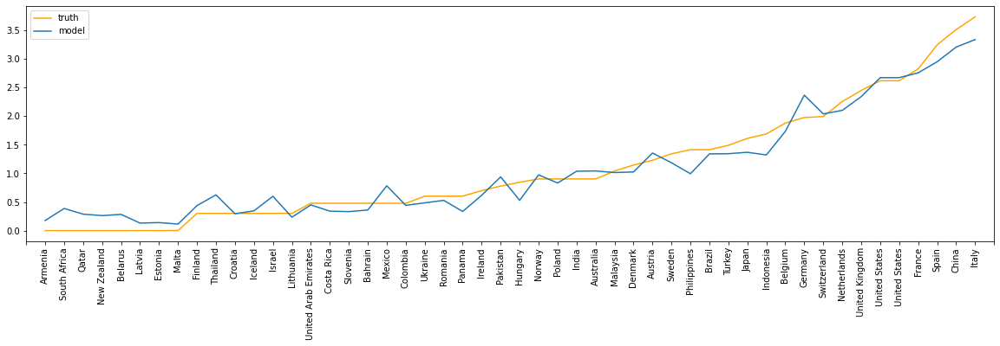

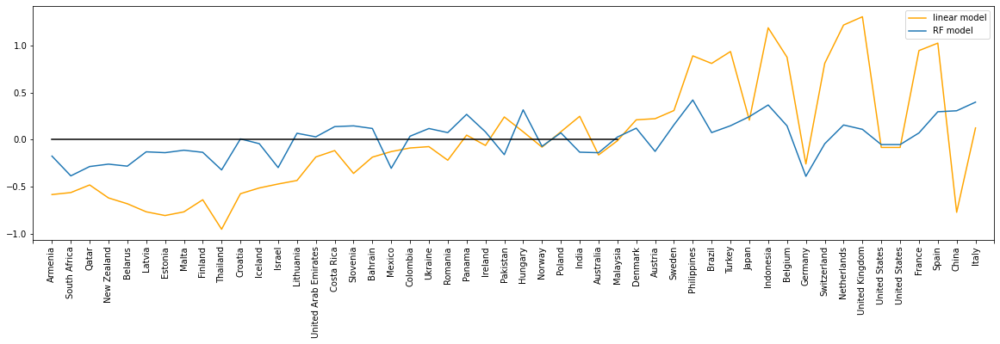

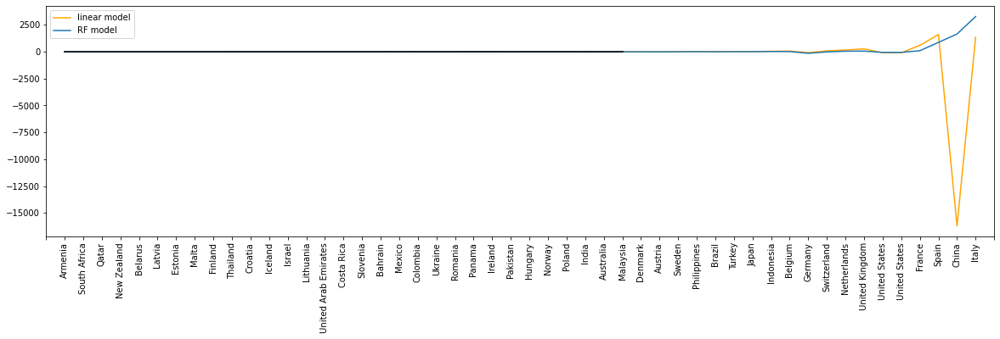

In [374]:
ax = np.log10(formodeling["totaldeaths"] + 1).plot(label="truth", c="orange", figsize=(20,5))
pl.plot(regr.predict(X), label="model")
pl.legend()
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.figure()

ax = (np.log10(formodeling["totaldeaths"] + 1) - 
      logtotaldeaths2.predict()).plot(label="linear model", c="orange", figsize=(20,5))
(np.log10(formodeling["totaldeaths"] + 1) - 
 regr.predict(X)).plot(ax=ax, label="RF model")
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.plot([0,30], [0,0], color='k');
pl.legend()

pl.figure()
ax = (formodeling["totaldeaths"] - 
      10**logtotaldeaths2.predict()).plot(label="linear model", c="orange", figsize=(20,5))
(formodeling["totaldeaths"] - 
 10**regr.predict(X)).plot(ax=ax, label="RF model")
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);
pl.plot([0,30], [0,0], color='k');
pl.legend()


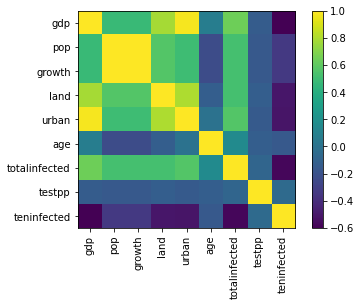

In [375]:
covMatrix = np.corrcoef(X.T)
pl.imshow((covMatrix))
pl.colorbar()
pl.xticks(range(len(features)), features, rotation=90)
pl.yticks(range(len(features)), features);

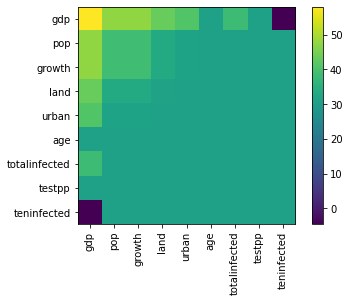

In [376]:
covMatrix = np.cov(X.T)
pl.imshow(np.log(covMatrix - covMatrix.min() + 0.01))
pl.colorbar()
pl.xticks(range(len(features)), features, rotation=90)
pl.yticks(range(len(features)), features);

In [377]:
importances = regr.feature_importances_
importances


std = np.std([tree.feature_importances_ for tree in regr.estimators_],
             axis=0)
indices = np.argsort(importances)[::-1]
importances[indices]

array([0.80842839, 0.07391935, 0.0300956 , 0.02187875, 0.01950413,
       0.0137526 , 0.01336308, 0.01068046, 0.00837765])

Feature ranking:
1. feature totalinfected (0.808428)
2. feature gdp (0.073919)
3. feature urban (0.030096)
4. feature growth (0.021879)
5. feature pop (0.019504)
6. feature land (0.013753)
7. feature testpp (0.013363)
8. feature age (0.010680)
9. feature teninfected (0.008378)


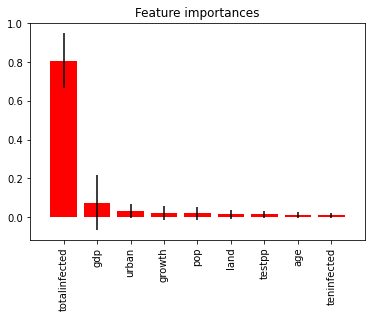

In [378]:
# Print the feature ranking
print("Feature ranking:")

for f in range(X.shape[1]):
    print("%d. feature %s (%f)" % (f + 1, np.array(features)[indices][f], importances[indices[f]]))

# Plot the feature importances of the forest
plt.figure()
plt.title("Feature importances")
plt.bar(range(X.shape[1]), importances[indices],
       color="r", yerr=std[indices], align="center")
plt.xticks(range(X.shape[1]), np.array(features)[indices], rotation=90)
plt.xlim([-1, X.shape[1]])
plt.show()

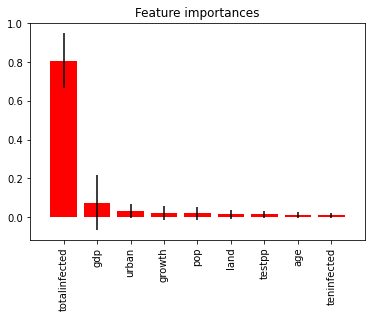

Feature ranking:
1. feature totalinfected (0.000050)
2. feature Intercept (0.043705)
3. feature testpp (0.043790)
4. feature pop (0.044010)
5. feature growth (0.044072)
6. feature teninfected (0.154736)
7. feature age (0.254148)
8. feature urban (0.588907)
9. feature gdp (0.686058)


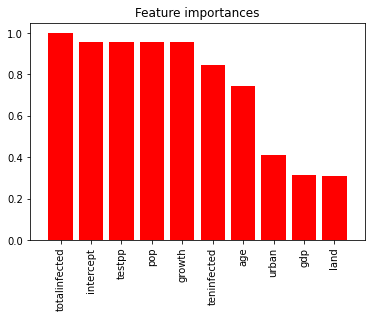

In [379]:
plt.figure()
plt.title("Feature importances")
plt.bar(range(X.shape[1]), importances[indices],
       color="r", yerr=std[indices], align="center")
plt.xticks(range(X.shape[1]),  np.array(features)[indices], rotation=90)
plt.xlim([-1, X.shape[1]])
plt.show()

importances = logtotaldeaths2.pvalues.values

indices = np.argsort(importances)

# Print the feature ranking
print("Feature ranking:")

for f in range(X.shape[1]):
    print("%d. feature %s (%f)" % (f + 1, 
        logtotaldeaths2.pvalues.index[indices[f]], importances[indices[f]]))

# Plot the feature importances of the forest
plt.figure()
plt.title("Feature importances")
plt.bar(range(X.shape[1] + 1), 1 - importances[indices],
       color="r",  align="center")
plt.xticks(range(X.shape[1] + 1), 
           list(np.array(["intercept"] + features)[indices]), 
rotation=90)
plt.xlim([-1, X.shape[1] + 1])
plt.show()



In [380]:
totaldeaths = smf.ols(formula="np.log10(totaldeaths +1)~ gdp + " + 
                      "pop	+ growth	+ land	+ urban + age + totalinfected + teninfected", 
                      data=formodeling).fit()
totaldeaths.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                OLS Regression Results                               
=====================================================================================
Dep. Variable:     np.log10(totaldeaths + 1)   R-squared:                       0.637
Model:                                   OLS   Adj. R-squared:                  0.576
Method:                        Least Squares   F-statistic:                     10.52
Date:                       Wed, 25 Mar 2020   Prob (F-statistic):           1.49e-07
Time:                               00:01:33   Log-Likelihood:                -44.851
No. Observations:                         50   AIC:                             105.7
Df Residuals:                             42   BIC:                             121.0
Df Model:                                  7                                         
Covariance Type:                   nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
Intercept         1.3428      0.646      2.080      0.044       0.040       2.646
gdp           -6.472e-14   1.59e-13     -0.407      0.686   -3.86e-13    2.56e-13
pop            4.432e-08   2.13e-08      2.077      0.044    1.25e-09    8.74e-08
growth        -4.445e-08   2.14e-08     -2.076      0.044   -8.77e-08   -1.24e-09
land          -2.603e-08   6.49e-08     -0.401      0.690   -1.57e-07    1.05e-07
urban          2.034e-06   3.73e-06      0.545      0.589    -5.5e-06    9.57e-06
age               0.0191      0.017      1.156      0.254      -0.014       0.052
totalinfected  4.253e-05   9.41e-06      4.518      0.000    2.35e-05    6.15e-05
teninfected      -0.0134      0.009     -1.449      0.155      -0.032       0.005
==============================================================================
Omnibus:                        3.818   Durbin-Watson:                   0.717
Prob(Omnibus):                  0.148   Jarque-Bera (JB):                3.601
Skew:                           0.601   Prob(JB):                        0.165
Kurtosis:                       2.468   Cond. No.                     9.47e+19
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The smallest eigenvalue is 1.1e-13. This might indicate that there are
strong multicollinearity problems or that the design matrix is singular.
"""

In [381]:
dead2test = smf.ols(formula="dead2test ~ " + 
                    "totalinfected + gdp +	pop	+growth	+ land + " + 
                    "urban +  age + tests", data=formodeling).fit()
dead2test.summary()

PatsyError: ignored

NameError: ignored

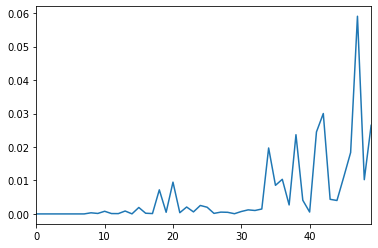

In [382]:
ax = formodeling["dead2test"].plot()
pl.plot(dead2test.predict())
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);


In [0]:
infected2test = smf.ols(formula="infected2test ~ " + 
                        "totalinfected + gdp +	pop	+ growth + " + 
                        "land	+ urban + age + tests", data=formodeling).fit()
infected2test.summary()

In [0]:
ax = formodeling["infected2test"].plot()
pl.plot(infected2test.predict())
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);


In [0]:
ax = formodeling["infected2test"].plot()
pl.plot(infected2test.predict())
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);


In [0]:
ax = formodeling["testpp"].plot()
pl.plot(testpp.predict())
ax.set_xticks(np.arange(-1, len(formodeling) + 1))
              # labels=formodeling["Country Name"].values)
ax.set_xticklabels(labels= [''] + list(
    formodeling["Country Name"].values), rotation=90);

In [0]:
infected

# Greg Dobler's analysis of the rate of infection

this par tof the analysis was performed by Greg Dobler (my husband and a colleague) on the evidence of a rutn over in the infection rate in various countries: China as a benchmark, Italy and the US, the countries we have a connection to


In [0]:

datag = infected.set_index("Country/Region").iloc[:, 2:N+2].T

In [0]:
datag.index = pd.to_datetime(datag.index)


In [0]:
datag.plot(y=["China", "United States", "Italy", "India"], use_index=True, 
           figsize=[10, 7], logy=True, style="o");

 ---

### **China: the infection rate turned around**

In [0]:
# -- plot day vs day-1
fig, ax = plt.subplots(figsize=[7, 7])
ax.scatter(datag[:]["China"].values[:-1], datag[:]["China"].values[1:])
ax.set_xlabel("Number of confirmed at day $t - 1$")
ax.set_ylabel("Number of confirmed at day $t$")
fig.show()

In [0]:
# -- fit two models

china_sub = datag[:]["China"].reset_index()
china_sub.columns = ["date", "counts"]
china_sub["day"] = np.arange(len(china_sub))
china_sub["lcounts"] = np.log10(china_sub["counts"])

lm0 = smf.ols("lcounts ~ day", data=china_sub)
lm1 = smf.ols("lcounts ~ day + np.power(day, 2)", data=china_sub)

res0 = lm0.fit()
res1 = lm1.fit()

pred0 = res0.predict(china_sub)
pred1 = res1.predict(china_sub)

In [0]:
# -- plot results
fig, ax = plt.subplots(figsize=[10, 5])
ax.plot(china_sub["day"], china_sub["lcounts"], "o", ms=10, label="data")
ax.plot(china_sub["day"], pred0, lw=4, label="linear model")
ax.plot(china_sub["day"], pred1, lw=4, c="limegreen", label="quadratic model")
ax.set_xlabel("days since 2020-02-26", fontsize=13)
ax.set_ylabel("log(number of confirmed cases)", fontsize=13)
ax.set_title("China", loc="right", fontsize=13)
ax.legend(fontsize=13)
fig.show()

In [0]:
# -- likelihood ratio test
lr, pval, ddf = res1.compare_lr_test(res0)

print("the integrated probability that the observed likelihood ratio \n" + 
      "occurred by random chance is {0:.2g}".format(pval))

---

### **US: no evidence or turnover yet**

In [0]:
# -- subset US
us_sub = datag[datag.index > "2020-02-29"]["United States"].reset_index()
us_sub.columns = ["date", "counts"]
us_sub["day"] = np.arange(len(us_sub))
us_sub["lcounts"] = np.log10(us_sub["counts"])

In [0]:
# -- plot it
us_sub.plot("day", "lcounts", style="o", figsize=[10, 5]);

In [0]:
# -- fit two models
lm0 = smf.ols("lcounts ~ day", data=us_sub)
lm1 = smf.ols("lcounts ~ day + np.power(day, 2)", data=us_sub)

res0 = lm0.fit()
res1 = lm1.fit()

pred0 = res0.predict(us_sub)
pred1 = res1.predict(us_sub)

In [0]:
# -- plot results
fig, ax = plt.subplots(figsize=[10, 5])
ax.plot(us_sub["day"], us_sub["lcounts"], "o", ms=10, label="data")
ax.plot(us_sub["day"], pred0, lw=4, label="linear model")
ax.plot(us_sub["day"], pred1, lw=4, c="limegreen", label="quadratic model")
ax.set_xlabel("days since 2020-02-26", fontsize=13)
ax.set_ylabel("log(number of confirmed cases)", fontsize=13)
ax.set_title("United States", loc="right", fontsize=13)
ax.legend(fontsize=13)
fig.show()

In [0]:
# -- likelihood ratio test
lr, pval, ddf = res1.compare_lr_test(res0)

print("the integrated probability that the observed likelihood ratio \n" + 
      "occurred by random chance is {0:.2g}".format(pval))

---

### **Italy: just turned around!**

In [0]:
# -- subset Italy
it_sub = datag[datag.index > "2020-02-29"]["Italy"].reset_index()
it_sub.columns = ["date", "counts"]
it_sub["day"] = np.arange(len(it_sub))
it_sub["lcounts"] = np.log10(it_sub["counts"])

In [0]:
# -- plot it
it_sub.plot("day", "lcounts", style="o", figsize=[10, 5]);

In [0]:
# -- fit two models
lm0 = smf.ols("lcounts ~ day", data=it_sub)
lm1 = smf.ols("lcounts ~ day + np.power(day, 2)", data=it_sub)

res0 = lm0.fit()
res1 = lm1.fit()

pred0 = res0.predict(it_sub)
pred1 = res1.predict(it_sub)

In [0]:
# -- plot results
fig, ax = plt.subplots(figsize=[10, 5])
ax.plot(it_sub["day"], it_sub["lcounts"], "o", ms=10, label="data")
ax.plot(it_sub["day"], pred0, lw=4, label="linear model")
ax.plot(it_sub["day"], pred1, lw=4, c="limegreen", label="quadratic model")
ax.set_xlabel("days since 2020-02-26", fontsize=13)
ax.set_ylabel("log(number of confirmed cases)", fontsize=13)
ax.set_title("Italy", loc="right", fontsize=13)
ax.legend(fontsize=13)
fig.show()

In [0]:
# -- likelihood ratio test
lr, pval, ddf = res1.compare_lr_test(res0)

print("the integrated probability that the observed likelihood ratio \n" + 
      "occurred by random chance is {0:.2g}".format(pval))